In [1]:
import pandas as pd
import sqlite3

# 1. Connect to the SQLite database
conn = sqlite3.connect('accident.db')

# List of table names
table_names = ["accident", "casualty", "lsoa", "vehicle"]

# Dictionary to store all tables as dataframes
dfs = {}

# 2. Loop through table names
for table in table_names:
    if table == "accident":
        query = f"""SELECT * FROM {table} 
                    WHERE strftime('%Y', 
                                   substr(date,7,4) || '-' || 
                                   substr(date,4,2) || '-' || 
                                   substr(date,1,2)) >= '2020'"""
    else:
        query = f"SELECT * FROM {table}"
    
    dfs[table] = pd.read_sql_query(query, conn)

# 3. Close the SQLite connection
conn.close()

In [2]:
dfs

{'accident':       accident_index  accident_year accident_reference  location_easting_osgr  \
 0      2020010219808           2020          010219808               521389.0   
 1      2020010220496           2020          010220496               529337.0   
 2      2020010228005           2020          010228005               526432.0   
 3      2020010228006           2020          010228006               538676.0   
 4      2020010228011           2020          010228011               529324.0   
 ...              ...            ...                ...                    ...   
 91194  2020991027064           2020          991027064               343034.0   
 91195  2020991029573           2020          991029573               257963.0   
 91196  2020991030297           2020          991030297               383664.0   
 91197  2020991030900           2020          991030900               277161.0   
 91198  2020991032575           2020          991032575               240402.0   
 
  

In [13]:
# joining the accident, casualty, and vehicle tables on the accident_index
merged_df = pd.merge(dfs['accident'], dfs['casualty'], on='accident_index', how='outer')
merged_df = pd.merge(merged_df, dfs['vehicle'], on='accident_index', how='outer')

# Now, join the above DataFrame with the lsoa table using the mentioned columns
final_df = pd.merge(merged_df, dfs['lsoa'], left_on='lsoa_of_accident_location', right_on='lsoa01cd', how='left')

print(final_df.head())


  accident_index  accident_year_x accident_reference_x  location_easting_osgr  \
0  2020010219808           2020.0            010219808               521389.0   
1  2020010220496           2020.0            010220496               529337.0   
2  2020010220496           2020.0            010220496               529337.0   
3  2020010228005           2020.0            010228005               526432.0   
4  2020010228006           2020.0            010228006               538676.0   

   location_northing_osgr  longitude   latitude  police_force  \
0                175144.0  -0.254001  51.462262           1.0   
1                176237.0  -0.139253  51.470327           1.0   
2                176237.0  -0.139253  51.470327           1.0   
3                182761.0  -0.178719  51.529614           1.0   
4                184371.0  -0.001683  51.541210           1.0   

   accident_severity  number_of_vehicles  ...  generic_make_model  \
0                3.0                 1.0  ...        

In [14]:
df = final_df.copy()

In [15]:
df = df.dropna()

#### Data Cleaning And Processing

/Users/mac/opt/anaconda3/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:1841: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])


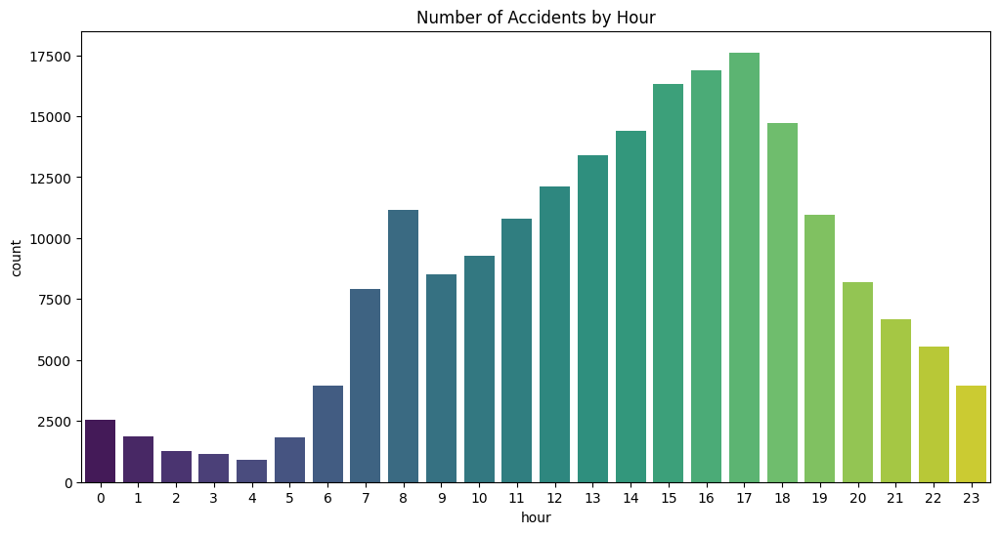

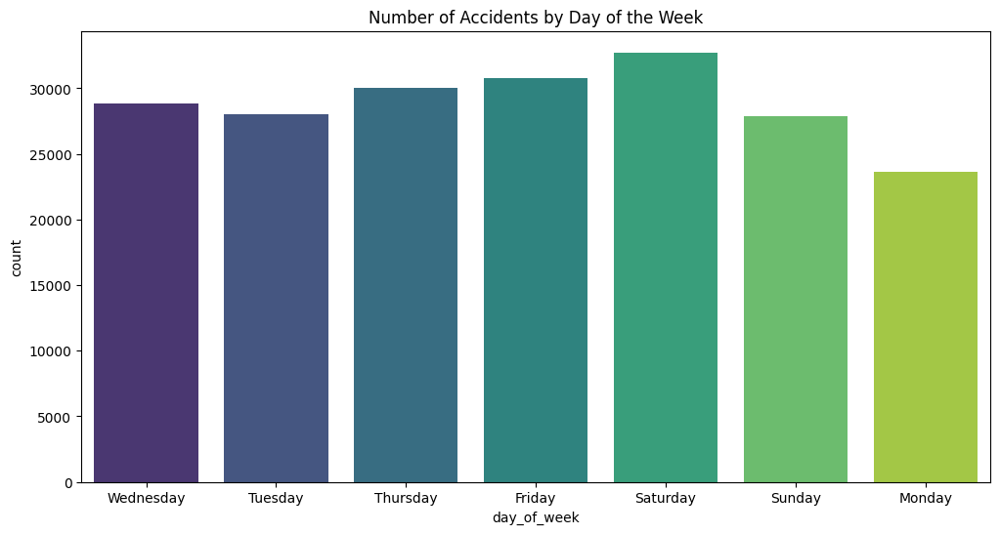

In [20]:
import seaborn as sns
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.pyplot as plt


day_map = {
    1: 'Monday',
    2: 'Tuesday',
    3: 'Wednesday',
    4: 'Thursday',
    5: 'Friday',
    6: 'Saturday',
    7: 'Sunday'
}
dg = df.copy()

# Extracting the hour from the time column
dg['hour'] = dg['time'].str.split(':').str[0].astype(int)
df['hour'] = df['time'].str.split(':').str[0].astype(int)
dg['day_of_week'] = dg['day_of_week'].map(day_map)

plt.figure(figsize=(12, 6))
sns.countplot(x='hour', data=dg, palette='viridis')
plt.title('Number of Accidents by Hour')
plt.show()

plt.figure(figsize=(12, 6))
sns.countplot(x='day_of_week', data=dg, palette='viridis')
plt.title('Number of Accidents by Day of the Week')
plt.show()

/Users/mac/opt/anaconda3/lib/python3.9/site-packages/pandas/core/algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:1841: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])
/var/folders/k_/9x515wpn05v792xf_7psj65w0000gn/T/ipykernel_19942/1002211513.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pa

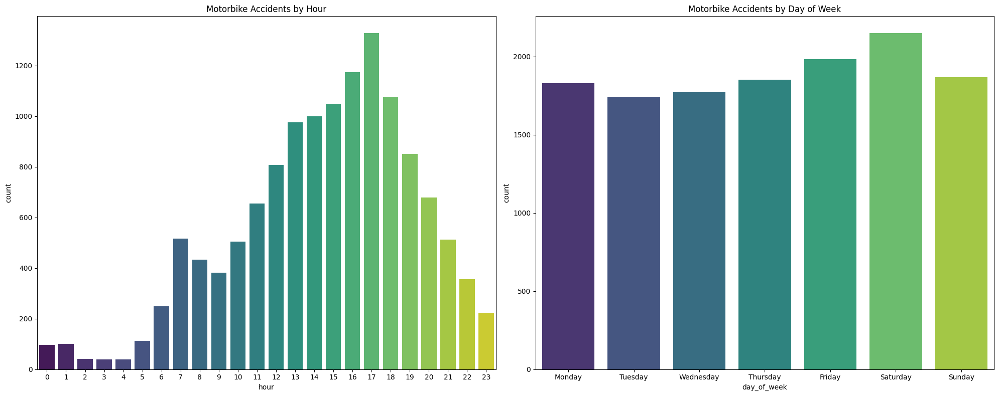

In [21]:
import matplotlib.pyplot as plt
import seaborn as sns

# List of motorbike codes
motorbike_codes = [3, 4, 5]

# Filter the DataFrame based on the motorbike codes
df_motorbikes = df[df['vehicle_type'].isin(motorbike_codes)]

# Mapping numbers to actual day names
day_map = {
    1: 'Monday',
    2: 'Tuesday',
    3: 'Wednesday',
    4: 'Thursday',
    5: 'Friday',
    6: 'Saturday',
    7: 'Sunday'
}
df_motorbikes['day_of_week'] = df_motorbikes['day_of_week'].map(day_map)

# Plotting the data
plt.figure(figsize=(20, 8))

plt.subplot(1, 2, 1)
sns.countplot(data=df_motorbikes, x='hour', palette='viridis')
plt.title('Motorbike Accidents by Hour')

plt.subplot(1, 2, 2)
sns.countplot(data=df_motorbikes, x='day_of_week', palette='viridis', order=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'])
plt.title('Motorbike Accidents by Day of Week')

plt.tight_layout()
plt.show()


/Users/mac/opt/anaconda3/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:1841: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])
/var/folders/k_/9x515wpn05v792xf_7psj65w0000gn/T/ipykernel_19942/692689773.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_pedestrian['day_of_week'] = df_pedestrian['day_of_week'].map(day_map)


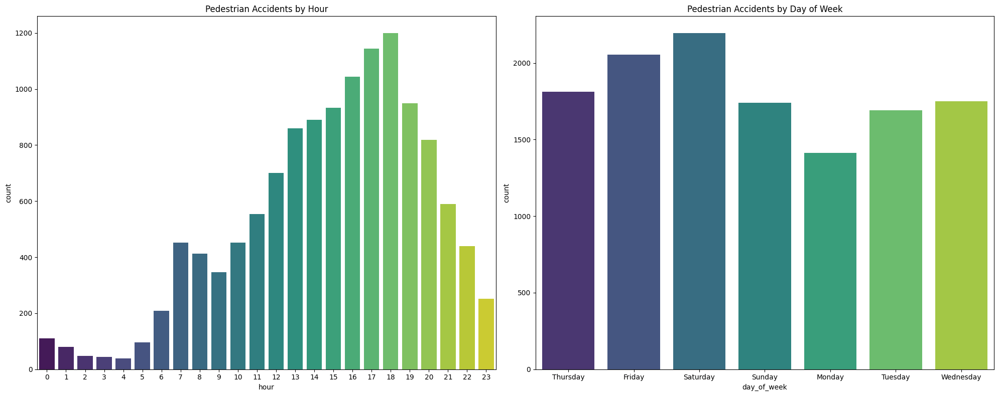

In [23]:
# Filter the DataFrame for pedestrian casualties using the code
df_pedestrian = df[df['casualty_type'] == 3]
df_pedestrian['day_of_week'] = df_pedestrian['day_of_week'].map(day_map)


# Plotting the data
plt.figure(figsize=(20, 8))

plt.subplot(1, 2, 1)
sns.countplot(data=df_pedestrian, x='hour', palette='viridis')
plt.title('Pedestrian Accidents by Hour')

plt.subplot(1, 2, 2)
sns.countplot(data=df_pedestrian, x='day_of_week', palette='viridis')
plt.title('Pedestrian Accidents by Day of Week')

plt.tight_layout()
plt.show()


Most accidents occur at 6pm and on Saturdays

#### APRIORI AND ASSOCIATION RULES.

In [26]:
from mlxtend.frequent_patterns import apriori, association_rules
# Selected columns based on relevance
selected_cols = ['accident_severity', 'weather_conditions', 'road_surface_conditions', 'light_conditions', 'speed_limit', 'junction_detail', 'junction_control', 'road_type', 'urban_or_rural_area', 'did_police_officer_attend_scene_of_accident', 'vehicle_type', 'vehicle_manoeuvre', 'skidding_and_overturning', 'first_point_of_impact', 'journey_purpose_of_driver']
df_for_apriori = df[selected_cols]

# Convert dataframe into list of lists for Apriori
transactions = df_for_apriori.values.tolist()

# Transform it into the right format
from mlxtend.preprocessing import TransactionEncoder

te = TransactionEncoder()
te_ary = te.fit(transactions).transform(transactions)
df_transformed = pd.DataFrame(te_ary, columns=te.columns_)

# Applying apriori
frequent_itemsets = apriori(df_transformed, min_support=0.05, use_colnames=True)
rules = association_rules(frequent_itemsets, metric="lift", min_threshold=1)

print(rules)


/Users/mac/opt/anaconda3/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:1841: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])


      antecedents                                 consequents  \
0           (0.0)                                      (-1.0)   
1          (-1.0)                                       (0.0)   
2           (2.0)                                      (-1.0)   
3          (-1.0)                                       (2.0)   
4           (5.0)                                      (-1.0)   
...           ...                                         ...   
20541       (0.0)  (1.0, 2.0, 3.0, 4.0, 6.0, 9.0, 18.0, 30.0)   
20542       (1.0)  (0.0, 2.0, 3.0, 4.0, 6.0, 9.0, 18.0, 30.0)   
20543       (4.0)  (0.0, 1.0, 2.0, 3.0, 6.0, 9.0, 18.0, 30.0)   
20544       (6.0)  (0.0, 1.0, 2.0, 3.0, 4.0, 9.0, 18.0, 30.0)   
20545      (30.0)   (0.0, 1.0, 2.0, 3.0, 4.0, 6.0, 9.0, 18.0)   

       antecedent support  consequent support   support  confidence      lift  \
0                0.901126            0.428844  0.426244    0.473013  1.102996   
1                0.428844            0.901126  0.426244  

In [27]:
filtered_rules = rules[(rules['lift'] > 1.2) & (rules['confidence'] > 0.6)]

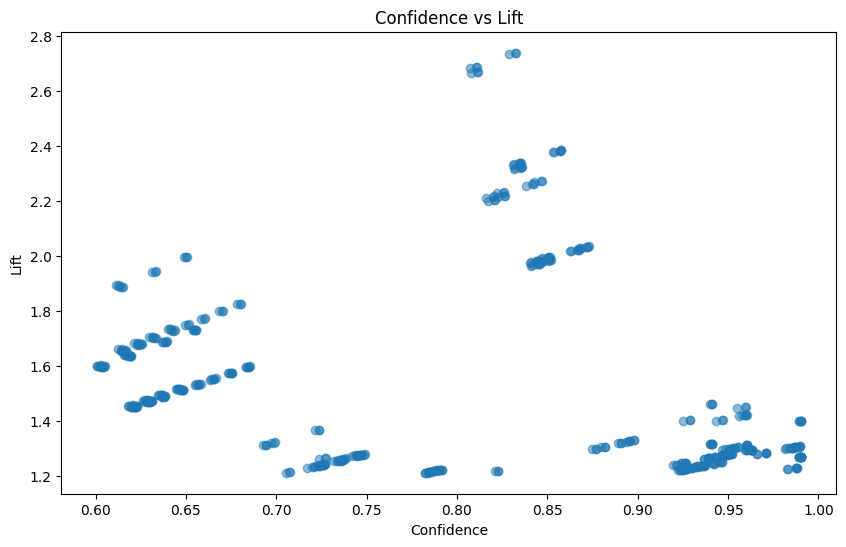

In [28]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.scatter(filtered_rules['confidence'], filtered_rules['lift'], alpha=0.5)
plt.xlabel('Confidence')
plt.ylabel('Lift')
plt.title('Confidence vs Lift')
plt.show()


In [51]:
rules

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,zhangs_metric
0,(0.0),(-1.0),0.901126,0.428844,0.426244,0.473013,1.102996,0.039802,1.083814,0.944413
1,(-1.0),(0.0),0.428844,0.901126,0.426244,0.993938,1.102996,0.039802,16.309950,0.163490
2,(2.0),(-1.0),0.832166,0.428844,0.372427,0.447539,1.043595,0.015558,1.033841,0.248902
3,(-1.0),(2.0),0.428844,0.832166,0.372427,0.868444,1.043595,0.015558,1.275766,0.073140
4,(5.0),(-1.0),0.257385,0.428844,0.118405,0.460030,1.072723,0.008027,1.057756,0.091289
...,...,...,...,...,...,...,...,...,...,...
20541,(0.0),"(1.0, 2.0, 3.0, 4.0, 6.0, 9.0, 18.0, 30.0)",0.901126,0.073194,0.068237,0.075724,1.034570,0.002280,1.002738,0.337957
20542,(1.0),"(0.0, 2.0, 3.0, 4.0, 6.0, 9.0, 18.0, 30.0)",0.998737,0.068301,0.068237,0.068323,1.000321,0.000022,1.000024,0.253836
20543,(4.0),"(0.0, 1.0, 2.0, 3.0, 6.0, 9.0, 18.0, 30.0)",0.638854,0.103777,0.068237,0.106812,1.029245,0.001939,1.003398,0.078678
20544,(6.0),"(0.0, 1.0, 2.0, 3.0, 4.0, 9.0, 18.0, 30.0)",0.903007,0.072213,0.068237,0.075566,1.046432,0.003028,1.003627,0.457477


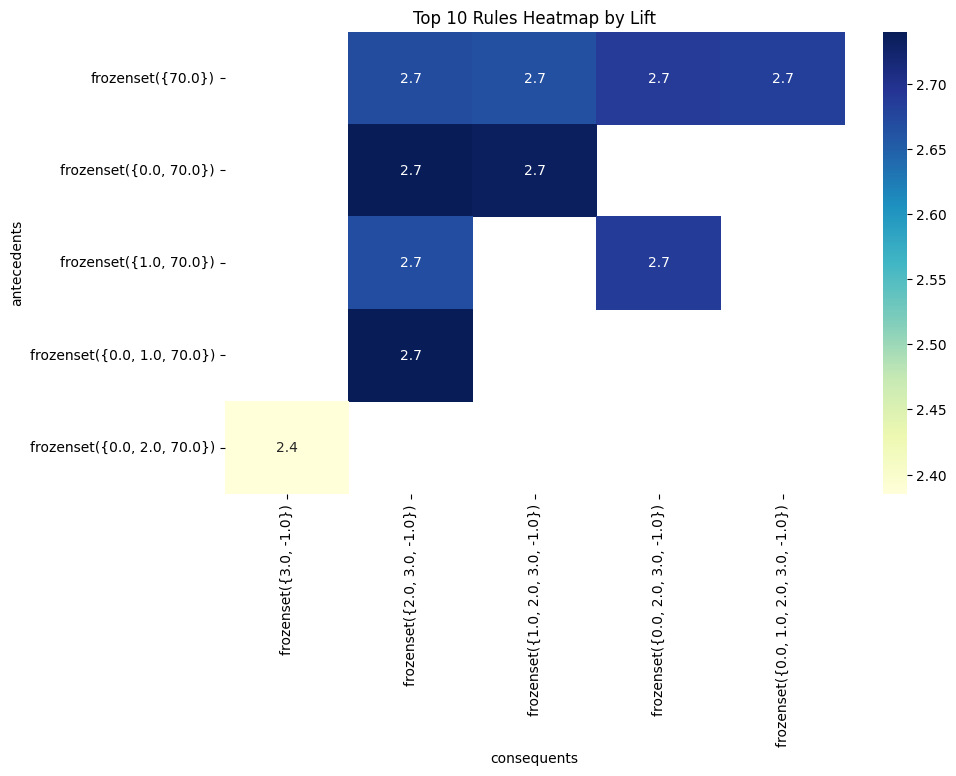

In [29]:
import seaborn as sns

top_10 = filtered_rules.nlargest(10, 'lift')

plt.figure(figsize=(10, 6))
sns.heatmap(top_10.pivot(index='antecedents', columns='consequents', values='lift'),
            cmap="YlGnBu", annot=True)
plt.title('Top 10 Rules Heatmap by Lift')
plt.show()


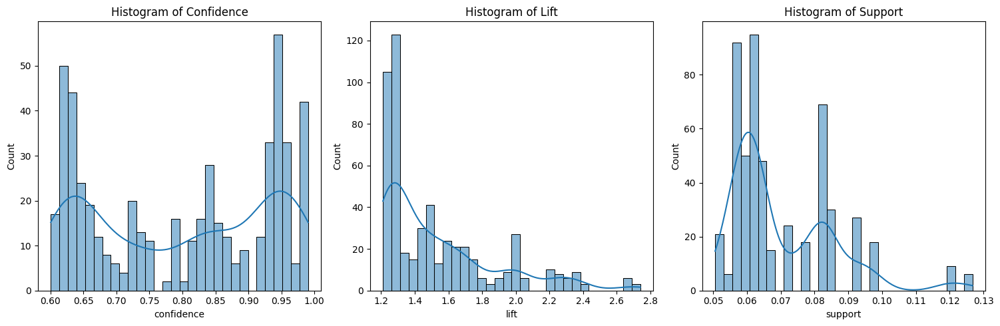

In [30]:
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

sns.histplot(filtered_rules['confidence'], ax=axes[0], kde=True, bins=30)
axes[0].set_title('Histogram of Confidence')

sns.histplot(filtered_rules['lift'], ax=axes[1], kde=True, bins=30)
axes[1].set_title('Histogram of Lift')

sns.histplot(filtered_rules['support'], ax=axes[2], kde=True, bins=30)
axes[2].set_title('Histogram of Support')

plt.tight_layout()
plt.show()

In [31]:
top_10

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,zhangs_metric
4319,"(0.0, 70.0)","(2.0, 3.0, -1.0)",0.068732,0.303908,0.057229,0.832637,2.739770,0.036341,4.159175,0.681873
9114,"(0.0, 1.0, 70.0)","(2.0, 3.0, -1.0)",0.068430,0.303908,0.056952,0.832260,2.738530,0.036155,4.149828,0.681474
9135,"(0.0, 70.0)","(1.0, 2.0, 3.0, -1.0)",0.068732,0.302991,0.056952,0.828602,2.734738,0.036126,4.066616,0.681151
4330,(70.0),"(0.0, 2.0, 3.0, -1.0)",0.070564,0.301714,0.057229,0.811018,2.688036,0.035939,3.694979,0.675659
9139,"(1.0, 70.0)","(0.0, 2.0, 3.0, -1.0)",0.070262,0.301714,0.056952,0.810557,2.686511,0.035753,3.686005,0.675212
9150,(70.0),"(0.0, 1.0, 2.0, 3.0, -1.0)",0.070564,0.300818,0.056952,0.807088,2.682981,0.035725,3.624354,0.674904
1482,(70.0),"(2.0, 3.0, -1.0)",0.070564,0.303908,0.057264,0.811509,2.670249,0.035819,3.692970,0.672992
4972,"(1.0, 70.0)","(2.0, 3.0, -1.0)",0.070262,0.303908,0.056986,0.811051,2.668742,0.035633,3.684019,0.672546
4982,(70.0),"(1.0, 2.0, 3.0, -1.0)",0.070564,0.302991,0.056986,0.807579,2.665352,0.035606,3.622309,0.672252
4308,"(0.0, 2.0, 70.0)","(3.0, -1.0)",0.066722,0.359606,0.057229,0.857726,2.385180,0.033235,4.501128,0.622263


### CLUSTERS

/Users/mac/opt/anaconda3/lib/python3.9/site-packages/pandas/core/algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:1841: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:1841: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more informati

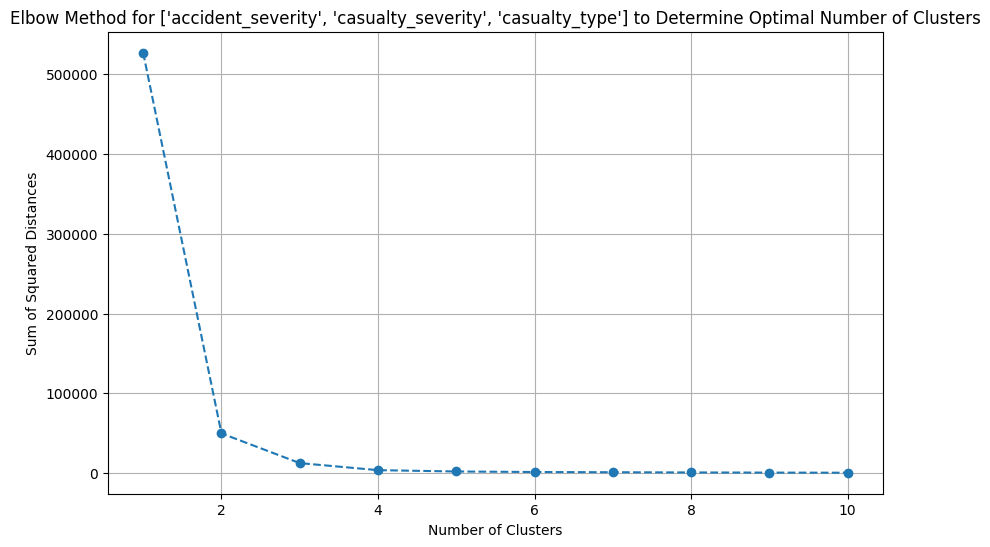

/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change fr

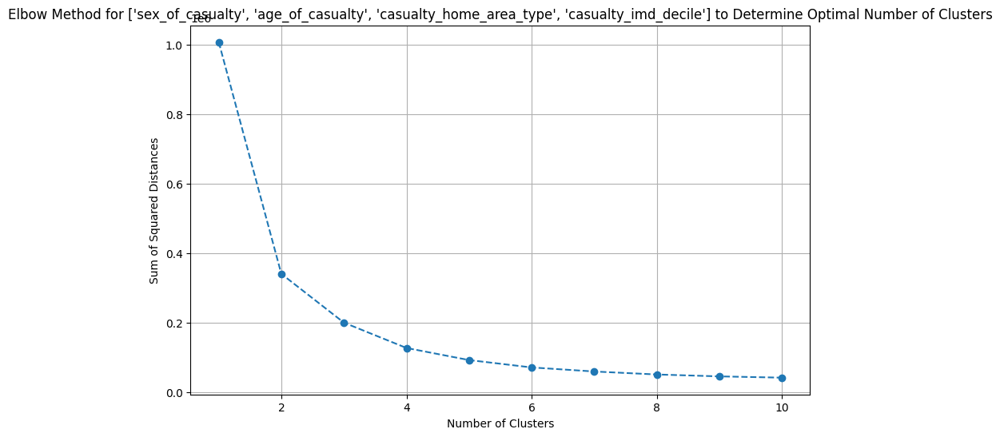

/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change fr

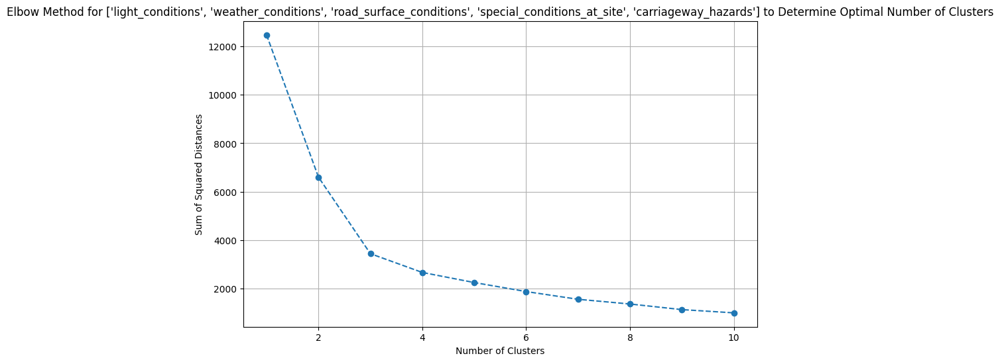

/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change fr

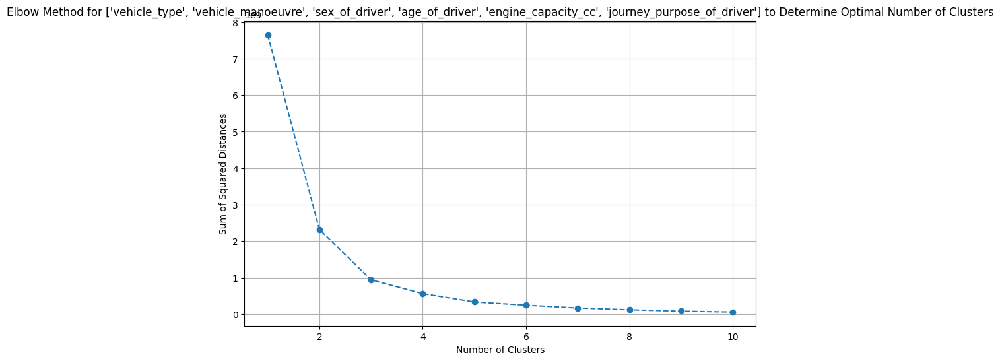

/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change fr

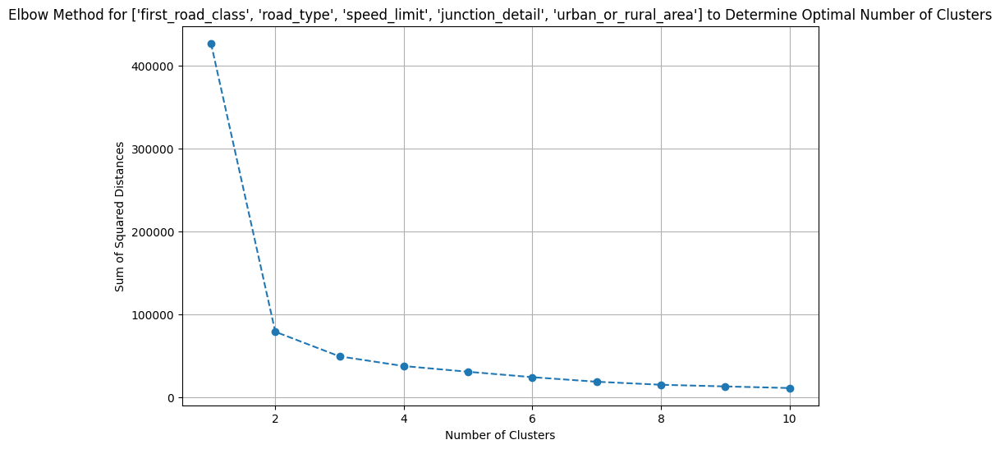

In [32]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import seaborn as sns

# Provided local authority codes for specific regions
regions_codes = ['E06000010', 'E06000011']

# Filter dataset for specific regions based on local authority codes
df_region = df[df['local_authority_ons_district'].isin(regions_codes)]

# Categories for clustering
categories = [
    ['accident_severity', 'casualty_severity', 'casualty_type'],
    ['sex_of_casualty', 'age_of_casualty', 'casualty_home_area_type', 'casualty_imd_decile'],
    ['light_conditions', 'weather_conditions', 'road_surface_conditions', 'special_conditions_at_site', 'carriageway_hazards'],
    ['vehicle_type', 'vehicle_manoeuvre', 'sex_of_driver', 'age_of_driver', 'engine_capacity_cc', 'journey_purpose_of_driver'], 
    ['first_road_class', 'road_type', 'speed_limit', 'junction_detail', 'urban_or_rural_area']
]

# Set a range for clusters
range_clusters = range(1, 11) 

for category in categories:
    X = df_region[category]
    X = X.fillna(X.mean())  # Handling missing data (if any) by filling with mean

    # Calculate the sum of squared distances
    ssd = []
    for num_clusters in range_clusters:
        kmeans = KMeans(n_clusters=num_clusters, random_state=42)
        kmeans.fit(X)
        ssd.append(kmeans.inertia_)

    # Plotting the elbow method
    plt.figure(figsize=(10, 6))
    plt.plot(range_clusters, ssd, marker='o', linestyle='--')
    plt.title(f'Elbow Method for {category} to Determine Optimal Number of Clusters')
    plt.xlabel('Number of Clusters')
    plt.ylabel('Sum of Squared Distances')
    plt.grid(True)
    plt.show()



/Users/mac/opt/anaconda3/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:1841: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:1841: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/var/folders/k_/9

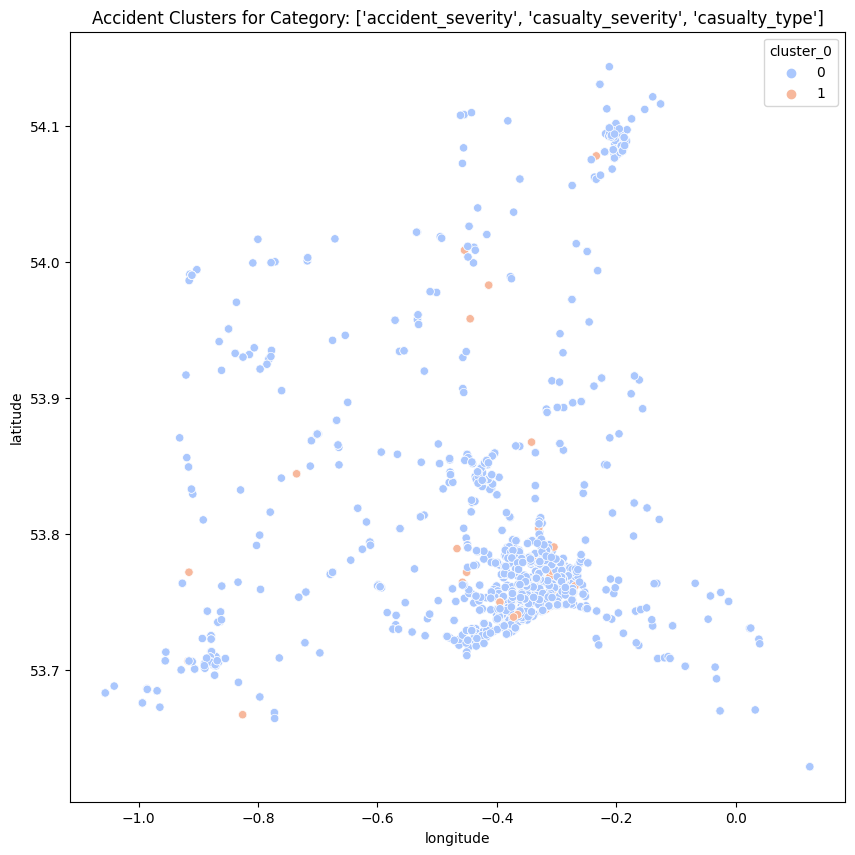

/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/var/folders/k_/9x515wpn05v792xf_7psj65w0000gn/T/ipykernel_19942/2553257498.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_region[f'cluster_{i}'] = kmeans.fit_predict(X)


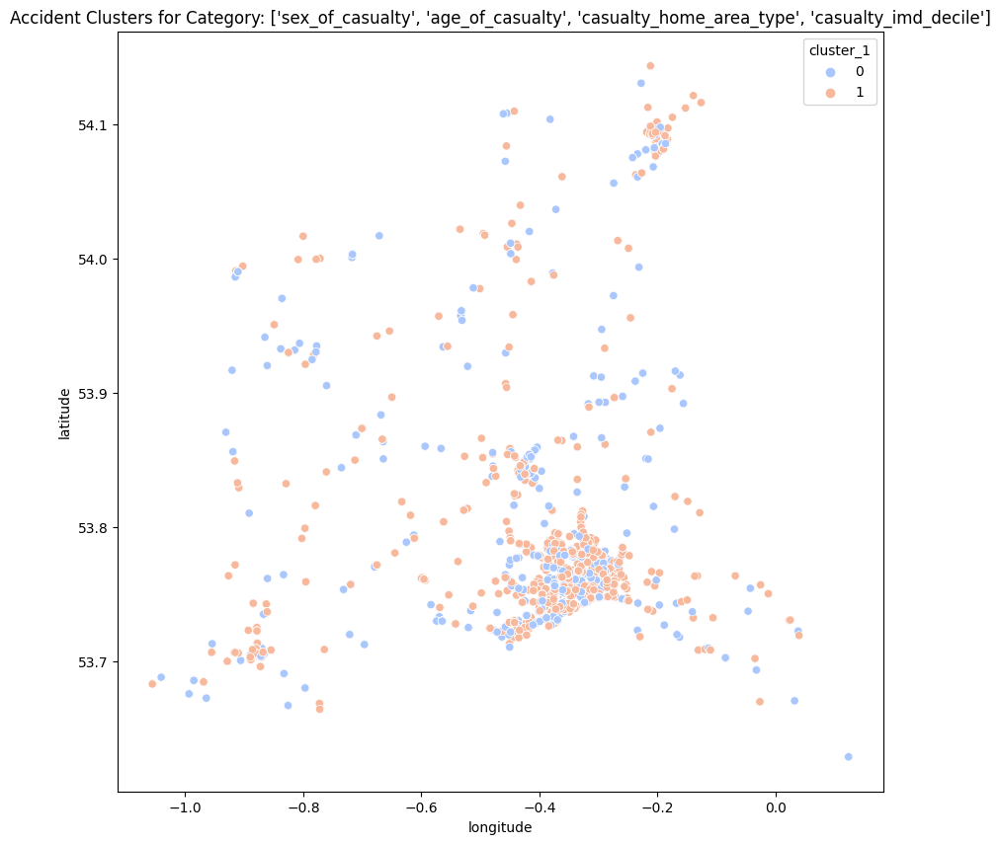

/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/var/folders/k_/9x515wpn05v792xf_7psj65w0000gn/T/ipykernel_19942/2553257498.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_region[f'cluster_{i}'] = kmeans.fit_predict(X)


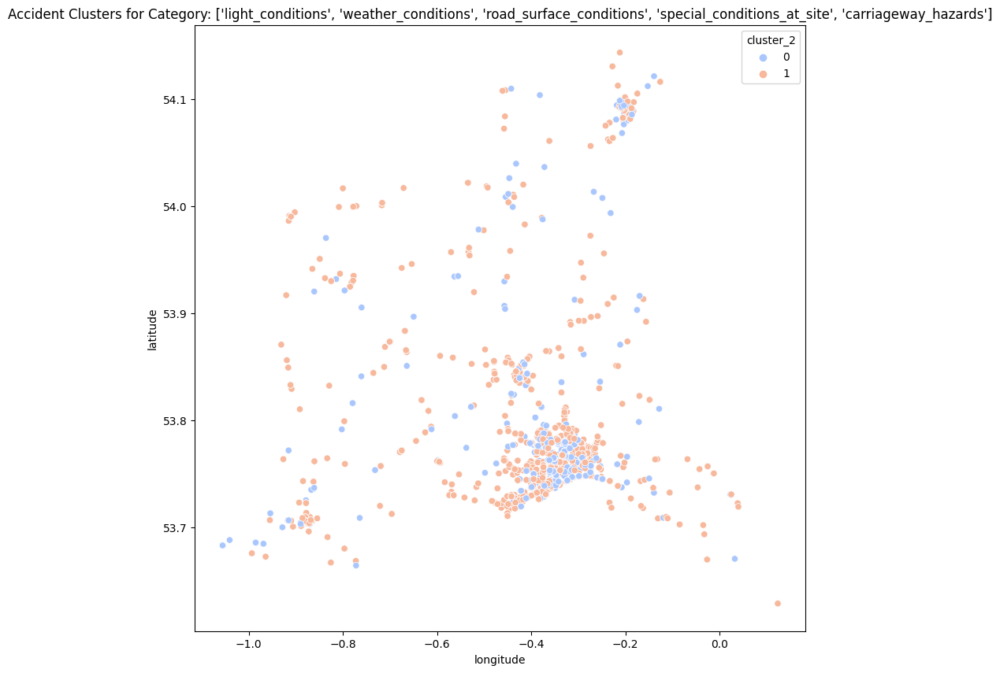

/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/var/folders/k_/9x515wpn05v792xf_7psj65w0000gn/T/ipykernel_19942/2553257498.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_region[f'cluster_{i}'] = kmeans.fit_predict(X)


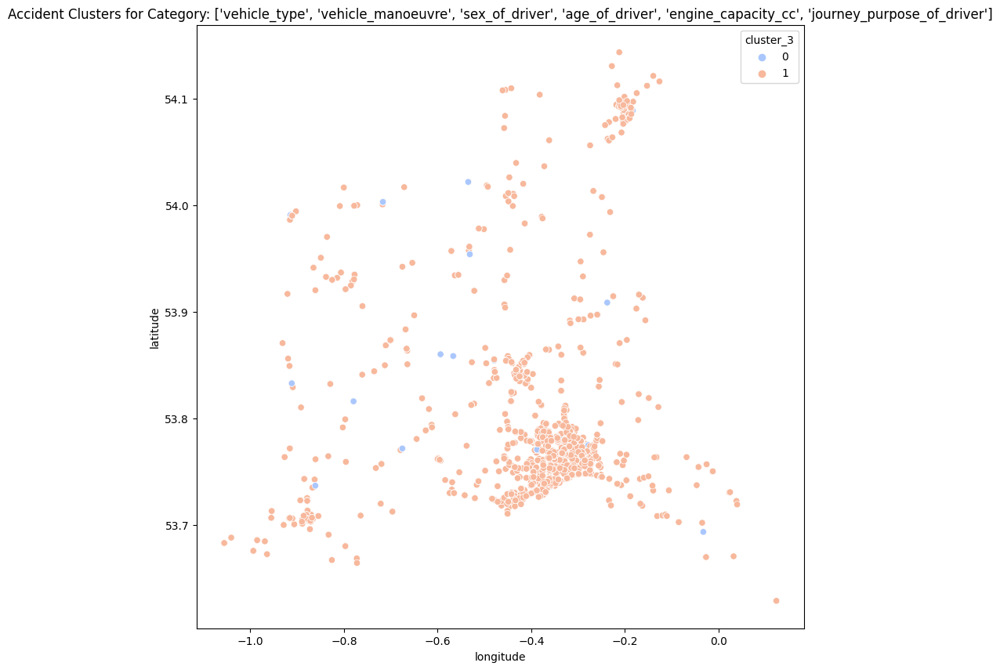

/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/var/folders/k_/9x515wpn05v792xf_7psj65w0000gn/T/ipykernel_19942/2553257498.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_region[f'cluster_{i}'] = kmeans.fit_predict(X)


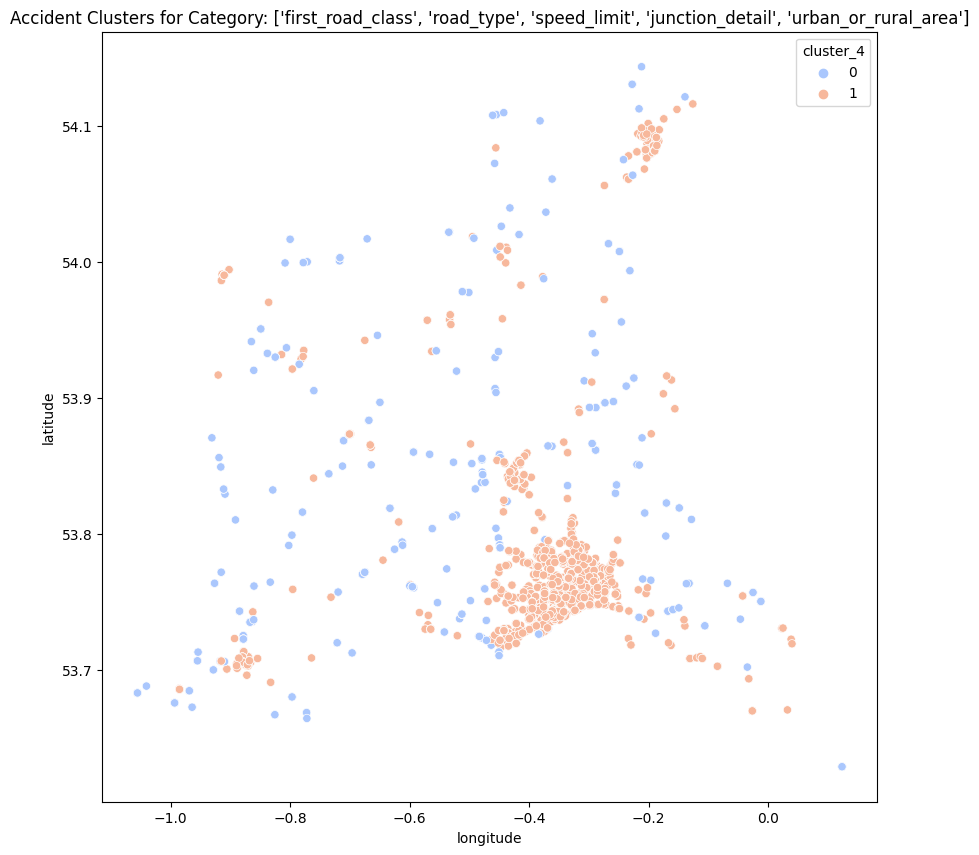

In [33]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import seaborn as sns


categories = [
    ['accident_severity', 'casualty_severity', 'casualty_type'],
    ['sex_of_casualty', 'age_of_casualty', 'casualty_home_area_type', 'casualty_imd_decile'],
    ['light_conditions', 'weather_conditions', 'road_surface_conditions', 'special_conditions_at_site', 'carriageway_hazards'],
    ['vehicle_type', 'vehicle_manoeuvre', 'sex_of_driver', 'age_of_driver', 'engine_capacity_cc', 'journey_purpose_of_driver'],
    ['first_road_class', 'road_type', 'speed_limit', 'junction_detail', 'urban_or_rural_area']
]

optimal_clusters = 2

for i, category in enumerate(categories):
    X = df_region[category]
    X = X.fillna(X.mean())
    
    kmeans = KMeans(n_clusters=optimal_clusters, random_state=42)
    df_region[f'cluster_{i}'] = kmeans.fit_predict(X)
    
    plt.figure(figsize=(10, 10))
    sns.scatterplot(x='longitude', y='latitude', hue=f'cluster_{i}', data=df_region, palette='coolwarm')
    plt.title(f'Accident Clusters for Category: {category}')
    plt.show()


### CLUSTERS

In [34]:

import folium
import numpy as np
import matplotlib.colors

# Define a function to generate a map for each category cluster
def generate_map(df, cluster_column, title):
    # Starting location for our map (approximately centered on Kingston Upon Hull)
    m = folium.Map(location=[53.7676, -0.3270], zoom_start=10)
    
    # Creating a color map
    colormap = plt.cm.get_cmap("viridis", np.unique(df[cluster_column]).max() + 1)
    
    for idx, row in df.iterrows():
        color = matplotlib.colors.to_hex(colormap(row[cluster_column]))
        folium.CircleMarker(
            location=[row['latitude'], row['longitude']],
            radius=5,
            popup=str(row[cluster_column]),
            color=color,
            fill=True,
            fill_color=color,
            fill_opacity=0.7,
        ).add_to(m)

    # Add a title
    title_html = '''
                 <h3 align="center" style="font-size:20px"><b>{}</b></h3>
                 '''.format(title)   
    m.get_root().html.add_child(folium.Element(title_html))
    
    return m


In [35]:

# Iterate through the cluster columns and display map for each
for i, category in enumerate(categories):
    m = generate_map(df_region, f'cluster_{i}', f'Clusters for Category: {category}')
    display(m)
    print(f"Map for category {i} saved as 'Category_{i}_map.html'")

/Users/mac/opt/anaconda3/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:1841: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])


Map for category 0 saved as 'Category_0_map.html'


/Users/mac/opt/anaconda3/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:1841: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])


Map for category 1 saved as 'Category_1_map.html'


/Users/mac/opt/anaconda3/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:1841: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])


Map for category 2 saved as 'Category_2_map.html'


/Users/mac/opt/anaconda3/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:1841: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])


Map for category 3 saved as 'Category_3_map.html'


/Users/mac/opt/anaconda3/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:1841: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])


Map for category 4 saved as 'Category_4_map.html'


In [36]:

def profile_cluster(df, cluster_column, features):
    # Create an empty dataframe to store cluster profiles
    cluster_profile = pd.DataFrame()

    # Calculate mean or mode for each feature per cluster
    for feature in features:
        if df[feature].dtype == 'object':  # Categorical variable
            cluster_mode = df.groupby(cluster_column)[feature].apply(lambda x: x.mode().iloc[0])
            cluster_profile[feature] = cluster_mode
        else:  # Numerical variable
            cluster_mean = df.groupby(cluster_column)[feature].mean()
            cluster_profile[feature] = cluster_mean

    return cluster_profile

# Iterate over categories and their respective clusters
for i, category in enumerate(categories):
    print(f"Cluster Profile for Category: {category}\n")
    profile = profile_cluster(df_region, f'cluster_{i}', category)
    print(profile, '\n\n' + '-'*50 + '\n')



Cluster Profile for Category: ['accident_severity', 'casualty_severity', 'casualty_type']

           accident_severity  casualty_severity  casualty_type
cluster_0                                                     
0                   2.775561           2.818786       6.443059
1                   2.901639           2.901639      95.950820 

--------------------------------------------------

Cluster Profile for Category: ['sex_of_casualty', 'age_of_casualty', 'casualty_home_area_type', 'casualty_imd_decile']

           sex_of_casualty  age_of_casualty  casualty_home_area_type  \
cluster_1                                                              
0                 1.415493        56.358149                 1.360161   
1                 1.378819        22.866259                 1.000000   

           casualty_imd_decile  
cluster_1                       
0                     4.571429  
1                     3.393075   

--------------------------------------------------

Cluster 

/Users/mac/opt/anaconda3/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:1841: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:1841: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:1841: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy

In [37]:
import folium

#import folium

def plot_and_print_centroids(df, latitude_col, longitude_col, cluster_col):
    m = folium.Map(location=[df[latitude_col].mean(), df[longitude_col].mean()], zoom_start=12)

    # Calculating the centroids
    centroids = df.groupby(cluster_col).mean()[[latitude_col, longitude_col]]

    # Print centroids
    print(f"Centroids for {cluster_col}:\n")
    for idx, row in centroids.iterrows():
        print(f"Cluster {idx} centroid is located at Latitude: {row[latitude_col]}, Longitude: {row[longitude_col]}")

    # Plot centroids on the map
    for idx, row in centroids.iterrows():
        folium.Marker([row[latitude_col], row[longitude_col]], 
                      popup=f"Centroid for Cluster {idx}",
                      icon=folium.Icon(color="red", icon="info-sign")).add_to(m)
    
    print("\n" + "-"*50 + "\n")  # Add separator for better readability when printing multiple centroids

    return m





In [38]:
# Using the function
for i in range(len(categories)):
    m = plot_and_print_centroids(df_region, 'latitude', 'longitude', f'cluster_{i}')
    m.save(f"centroid_map_{i}.html") 


Centroids for cluster_0:

Cluster 0 centroid is located at Latitude: 53.7993522003325, Longitude: -0.41052108437240237
Cluster 1 centroid is located at Latitude: 53.82344754098361, Longitude: -0.43709939344262294

--------------------------------------------------

Centroids for cluster_1:

Cluster 0 centroid is located at Latitude: 53.8075610362173, Longitude: -0.41966995774647886
Cluster 1 centroid is located at Latitude: 53.79481060692464, Longitude: -0.40544796605566874

--------------------------------------------------

Centroids for cluster_2:

Cluster 0 centroid is located at Latitude: 53.796404866766466, Longitude: -0.4071443218562874
Cluster 1 centroid is located at Latitude: 53.801263614785995, Longitude: -0.41267614508060035

--------------------------------------------------

Centroids for cluster_3:

Cluster 0 centroid is located at Latitude: 53.80362409375, Longitude: -0.43056148437499997
Cluster 1 centroid is located at Latitude: 53.79985008406159, Longitude: -0.4106620

### OUTLIERS AND ANOMALIES

In [39]:
from sklearn.ensemble import IsolationForest

# Define a function for anomaly detection
def detect_anomalies(df, features):
    # Instantiate model
    model = IsolationForest(contamination=0.05)  # 5% of data considered as anomalies
    anomalies = model.fit_predict(df[features])
    df['anomaly'] = anomalies

    # Plot anomalies on the map
    m = folium.Map(location=[df['latitude'].mean(), df['longitude'].mean()], zoom_start=12)

    for _, row in df[df['anomaly'] == -1].iterrows():
        folium.CircleMarker(
            location=[row['latitude'], row['longitude']],
            radius=5,
            color='red',
            fill=True,
            fill_color='red',
            fill_opacity=0.6
        ).add_to(m)

    return m


m = detect_anomalies(df_region, categories[0])
display(m)  


/Users/mac/opt/anaconda3/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:1841: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:1841: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])
/var/folders/k_/9x515wpn05v792xf_7psj65w0000gn/T/ipykernel_19942/2056932442.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-

### UNIVARIATE ANALYSIS

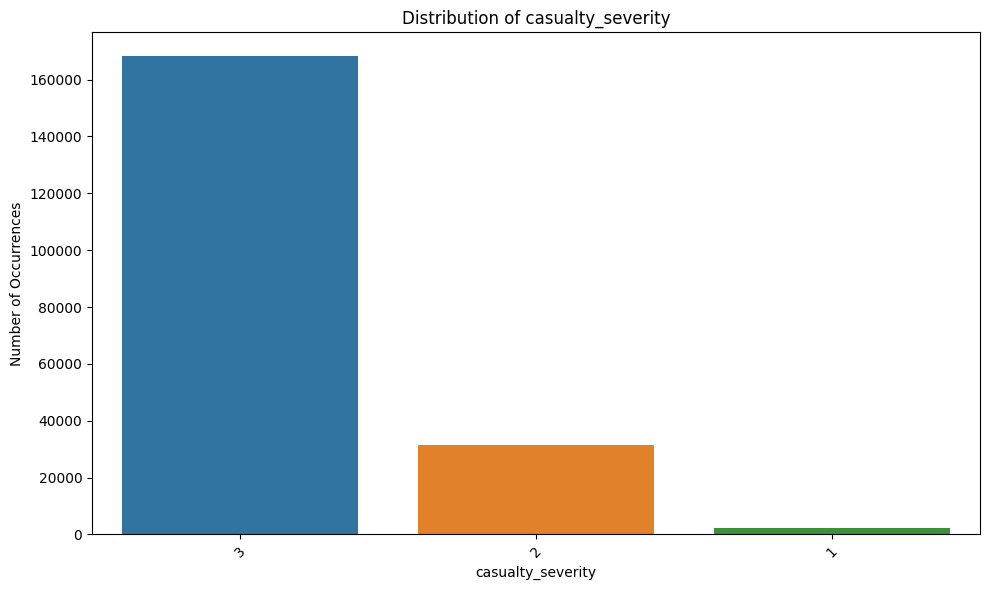

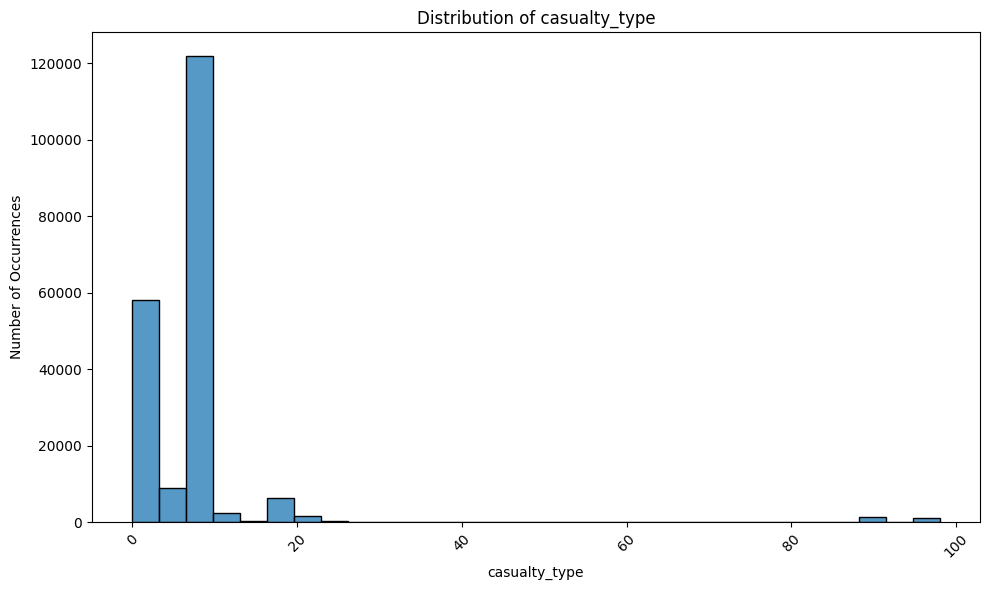

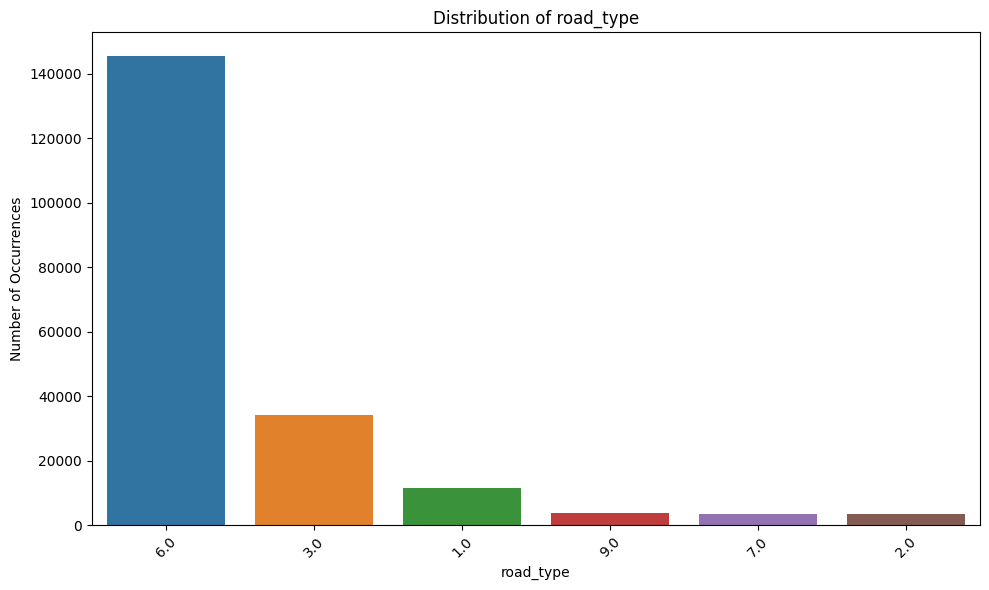

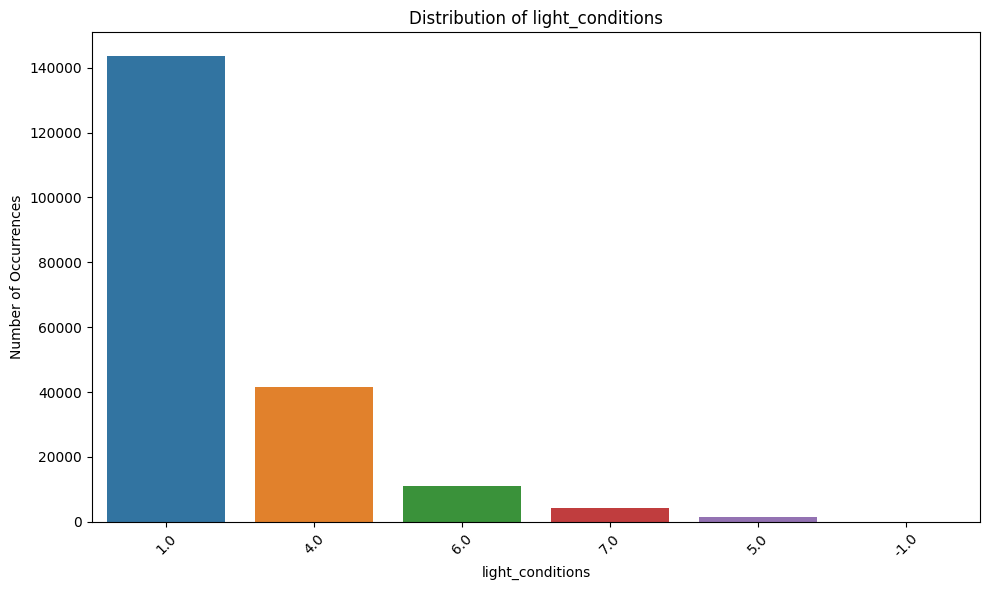

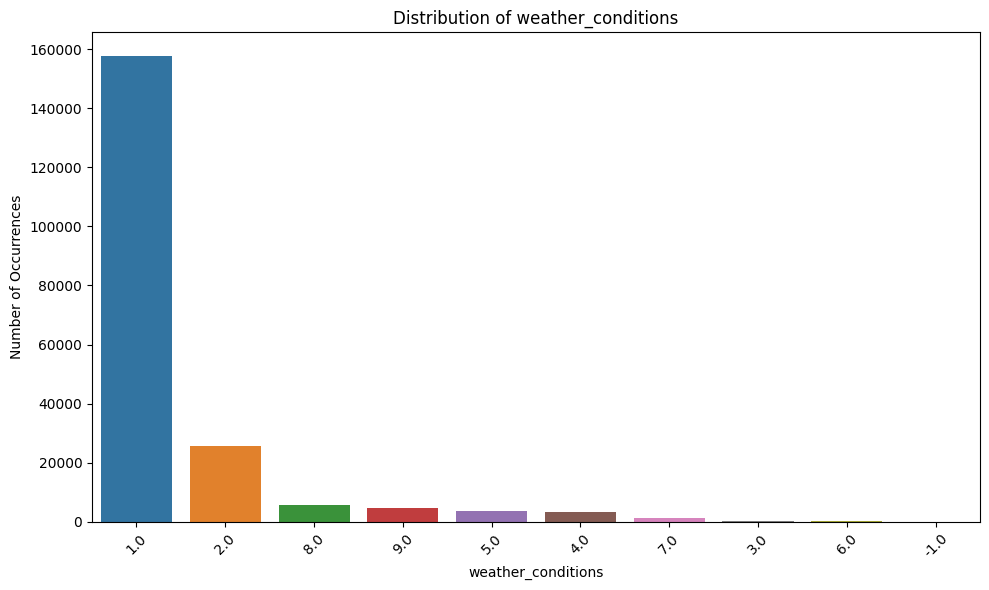

...

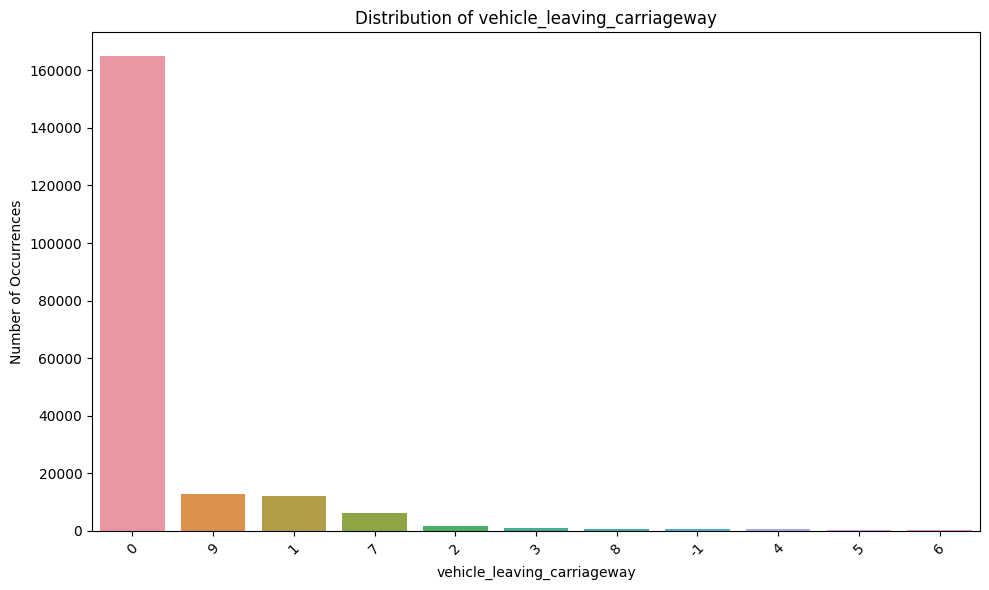

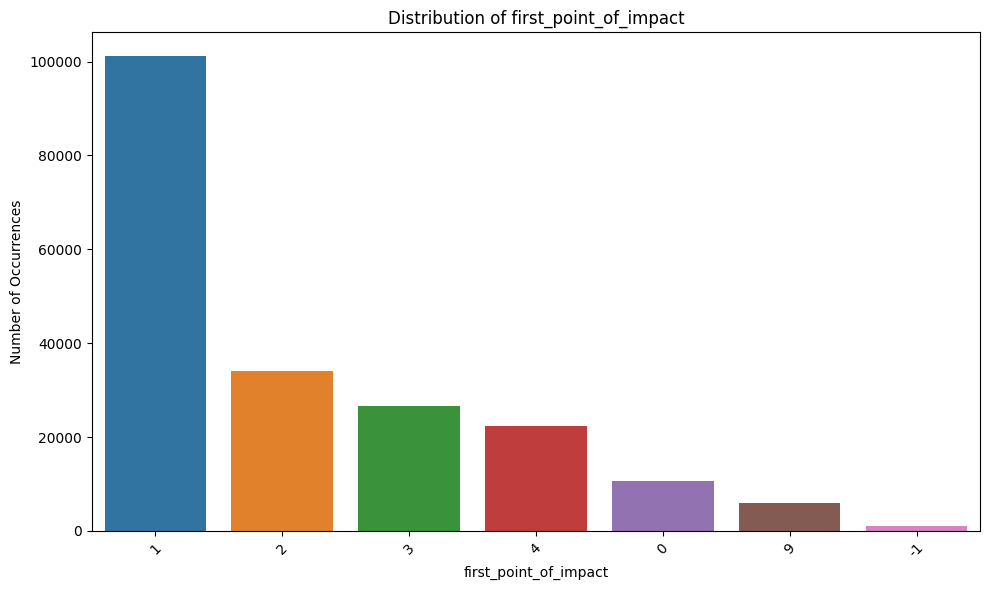

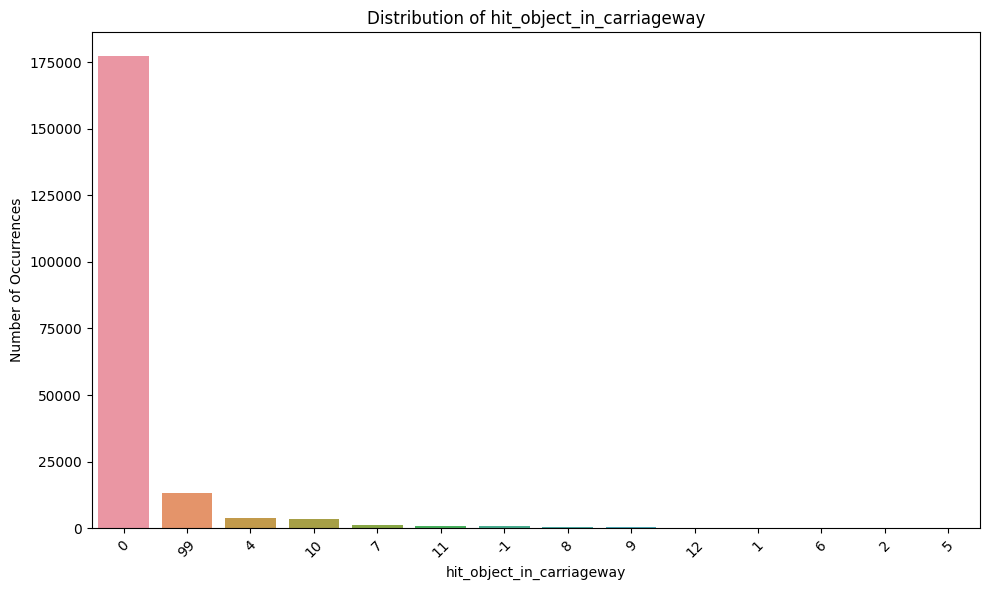

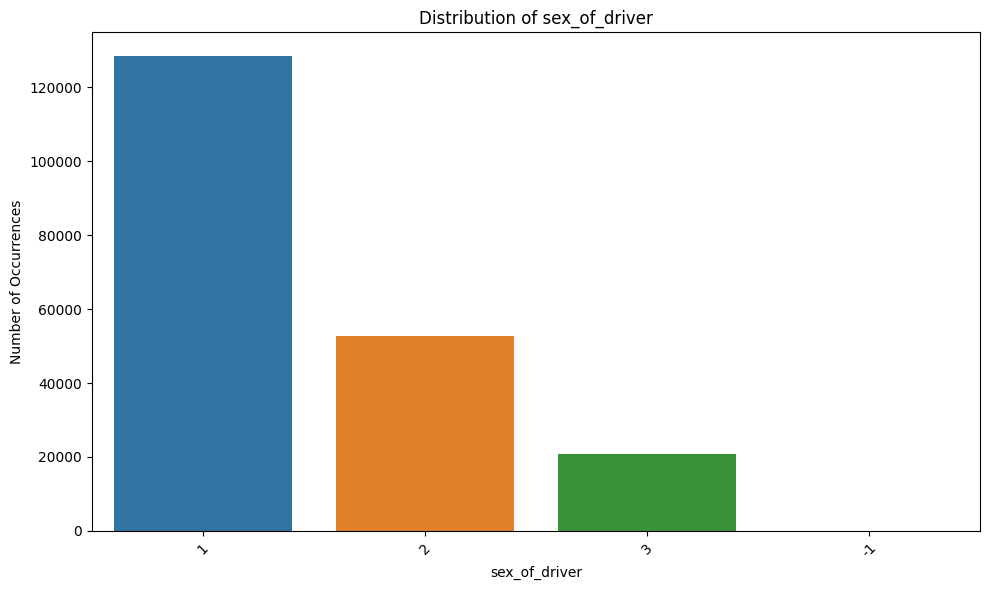

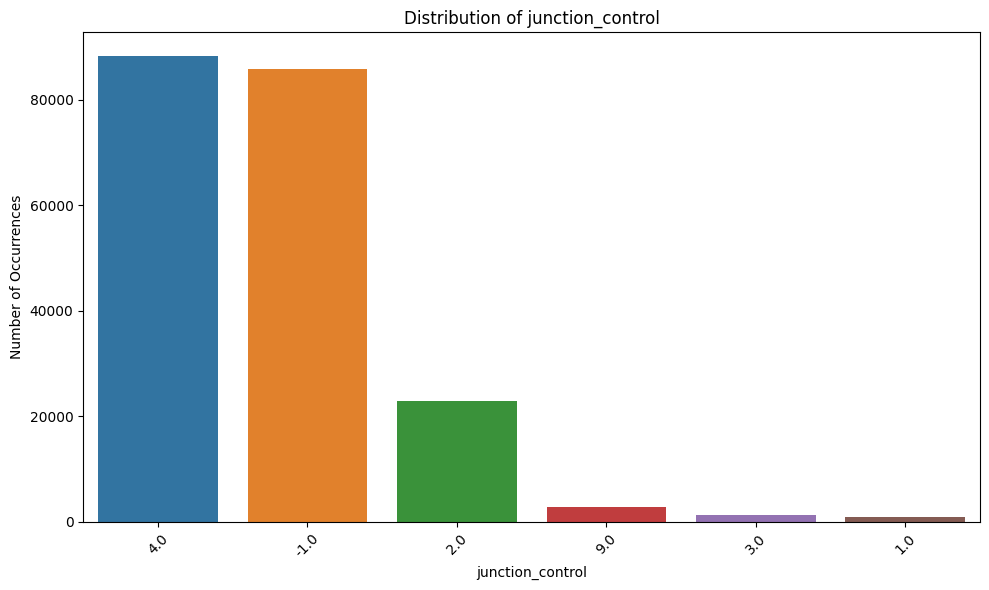

In [60]:
import matplotlib.pyplot as plt
import seaborn as sns

def visualize_columns(df, columns):
    for col in columns:
        plt.figure(figsize=(10, 6))
        
        # If the number of unique values is above a threshold, consider it continuous and use a histogram
        if len(df[col].unique()) > 20:
            sns.histplot(df[col], kde=False, bins=30)
        else:
            sns.countplot(x=col, data=df, order=df[col].value_counts().index)
        
        plt.title(f'Distribution of {col}')
        plt.ylabel('Number of Occurrences')
        plt.xlabel(col)
        plt.xticks(rotation=45)
        plt.tight_layout()
        plt.show()

key_columns = ['casualty_severity', 'casualty_type', 'road_type', 'light_conditions', 'weather_conditions', 'road_surface_conditions', 'special_conditions_at_site', 'junction_detail', 'speed_limit', 'carriageway_hazards', 'vehicle_leaving_carriageway', 'first_point_of_impact','hit_object_in_carriageway','sex_of_driver', 'junction_control']
visualize_columns(T, key_columns)


In [57]:
T.columns

Index(['police_force', 'accident_severity', 'number_of_vehicles',
       'number_of_casualties', 'day_of_week', 'first_road_class', 'road_type',
       'speed_limit', 'junction_detail', 'junction_control',
       'second_road_class', 'pedestrian_crossing_human_control',
       'pedestrian_crossing_physical_facilities', 'light_conditions',
       'weather_conditions', 'road_surface_conditions',
       'special_conditions_at_site', 'carriageway_hazards',
       'urban_or_rural_area', 'did_police_officer_attend_scene_of_accident',
       'trunk_road_flag', 'accident_year_y', 'accident_reference_y',
       'vehicle_reference_x', 'casualty_reference', 'casualty_class',
       'sex_of_casualty', 'age_of_casualty', 'age_band_of_casualty',
       'casualty_severity', 'pedestrian_location', 'pedestrian_movement',
       'car_passenger', 'bus_or_coach_passenger',
       'pedestrian_road_maintenance_worker', 'casualty_type',
       'casualty_home_area_type', 'casualty_imd_decile', 'vehicle_index'

### BIVARIATE ANALYSIS

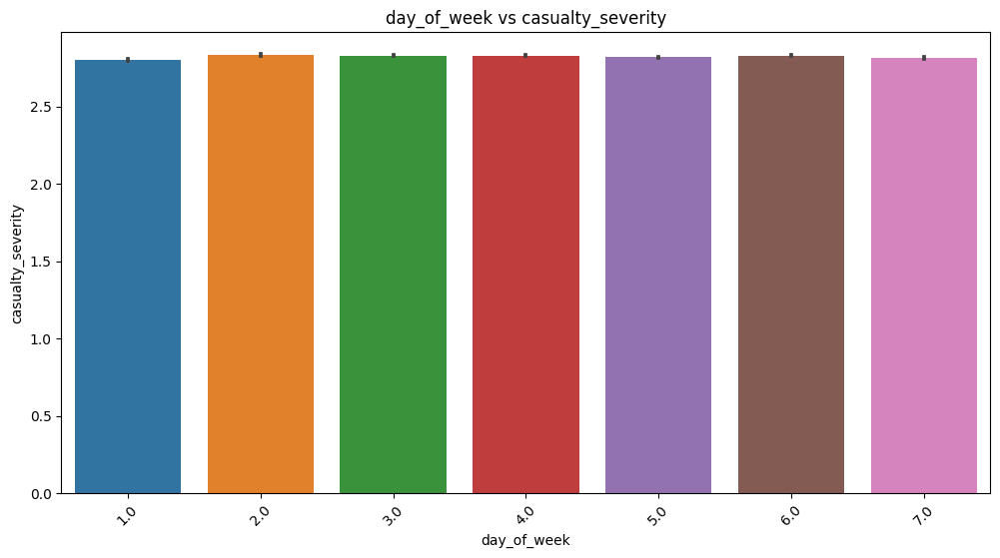

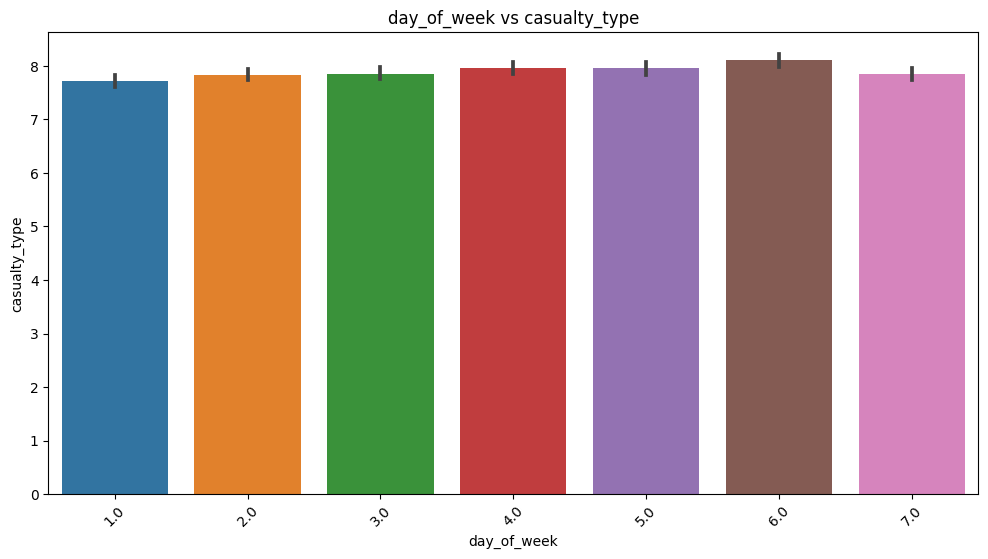

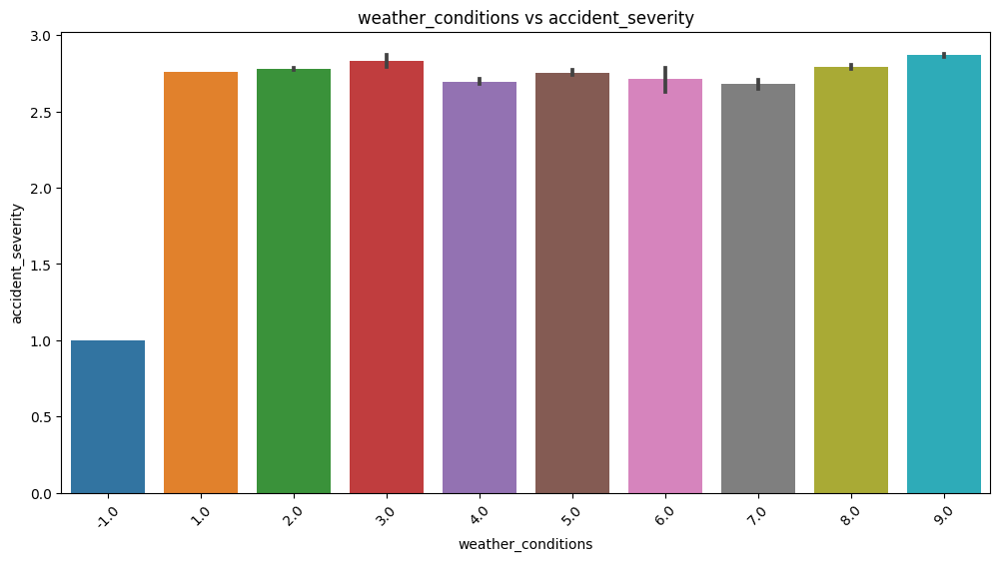

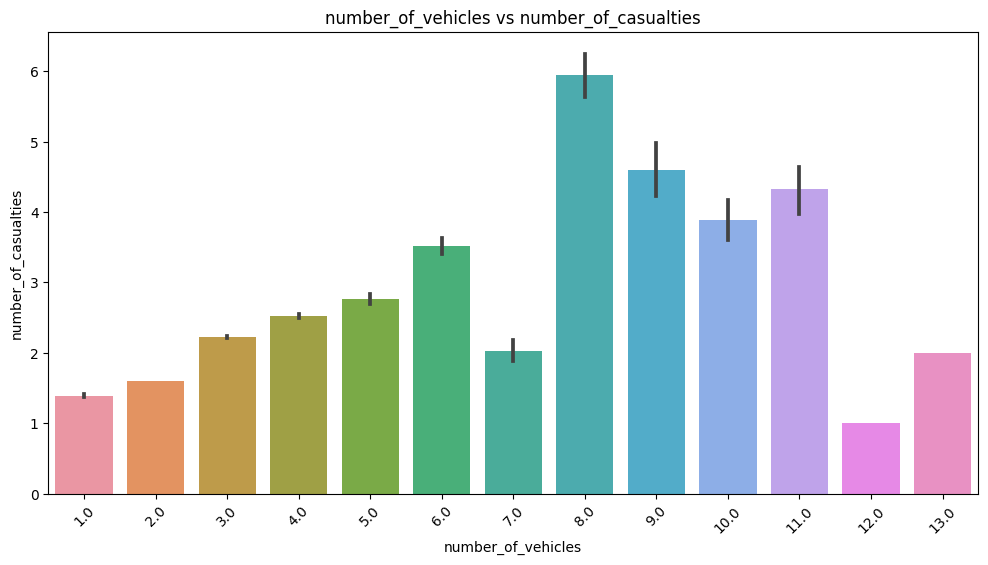

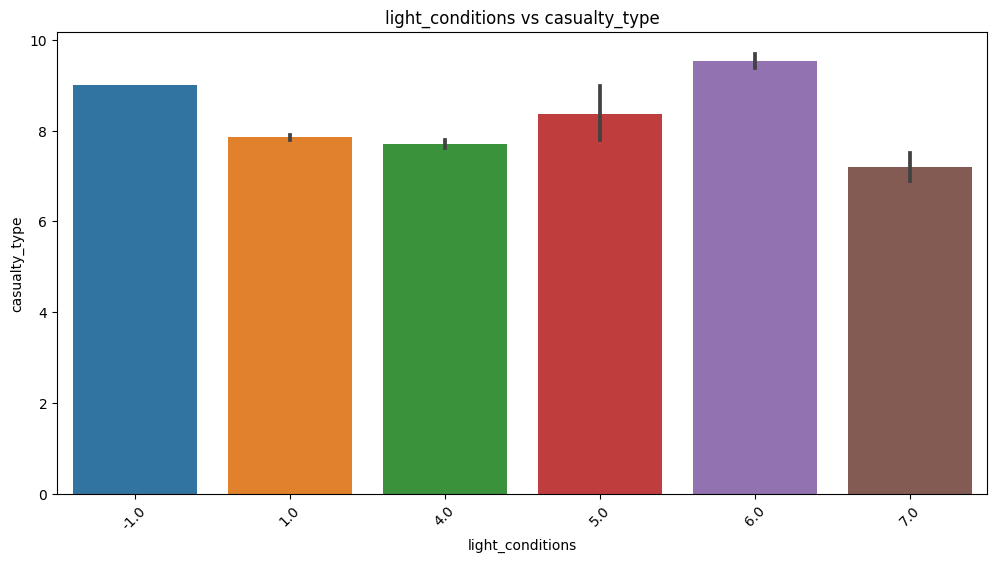

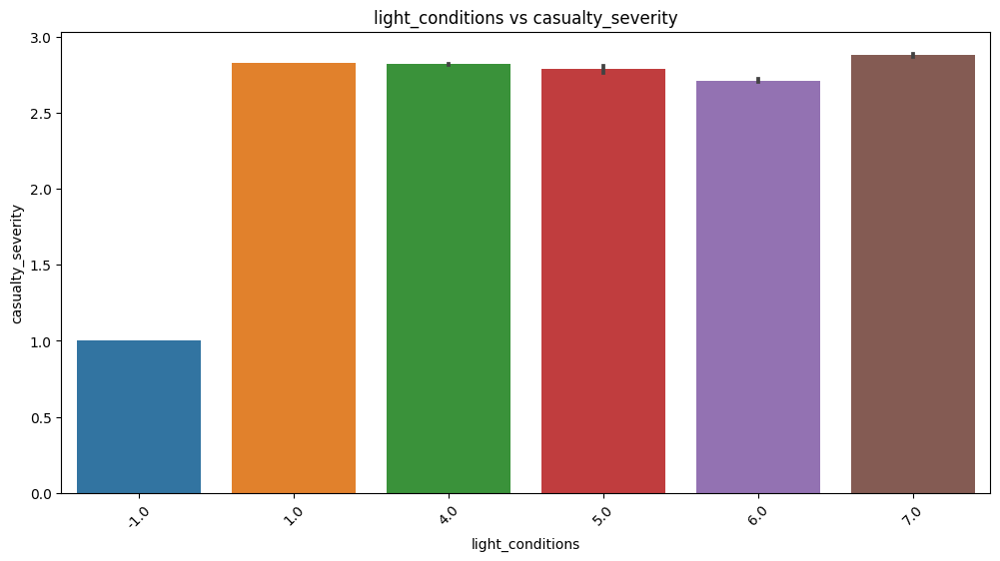

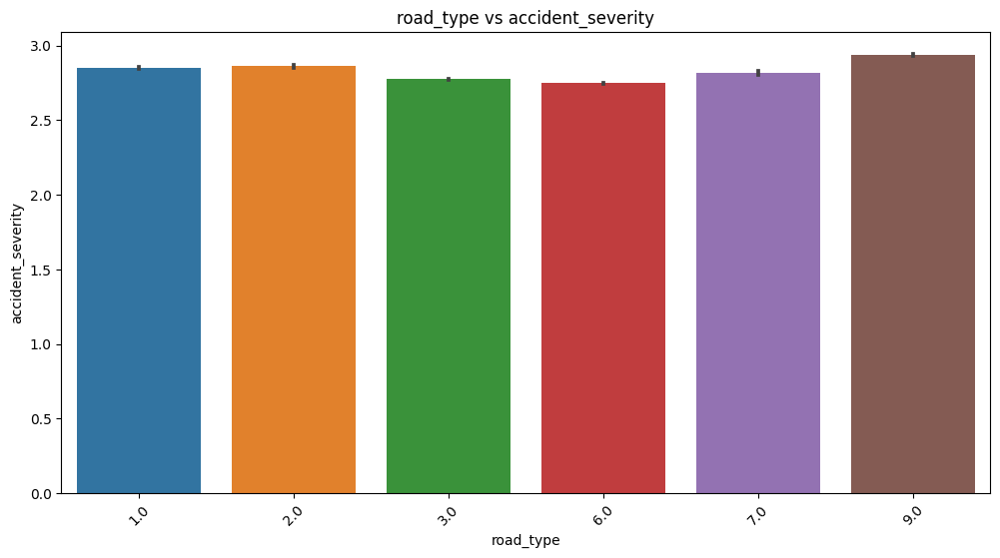

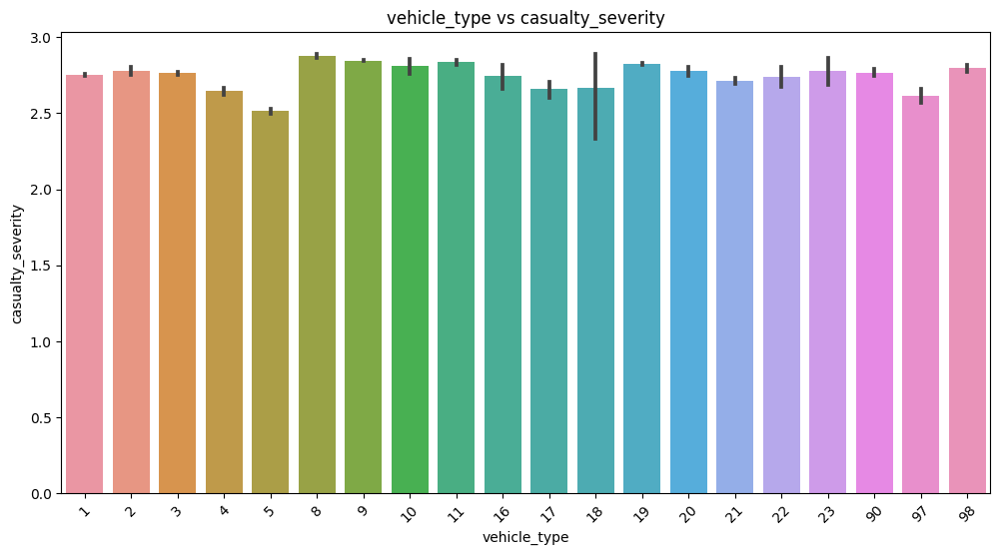

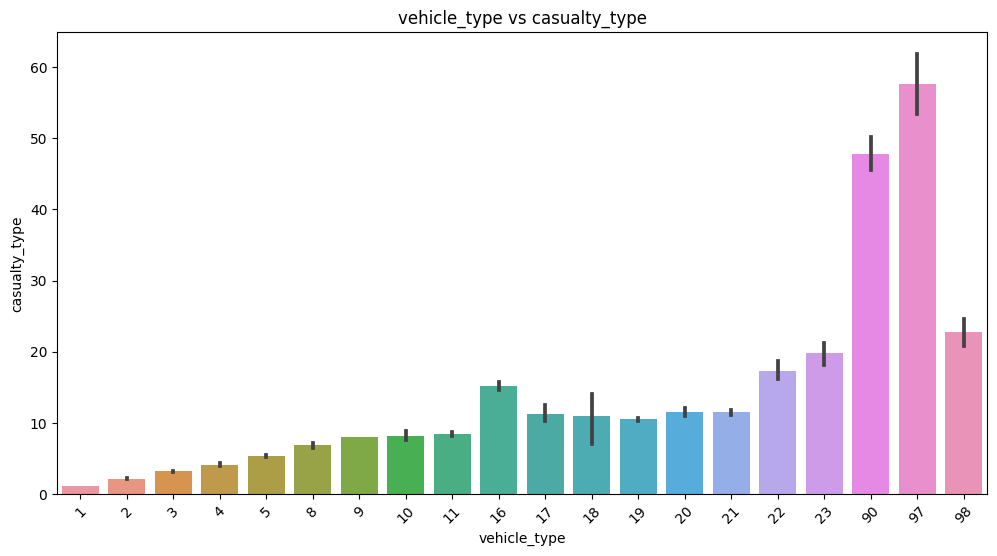

Skipping visualization for day_of_week vs number_of_accidents as one of them is not present in the dataframe.


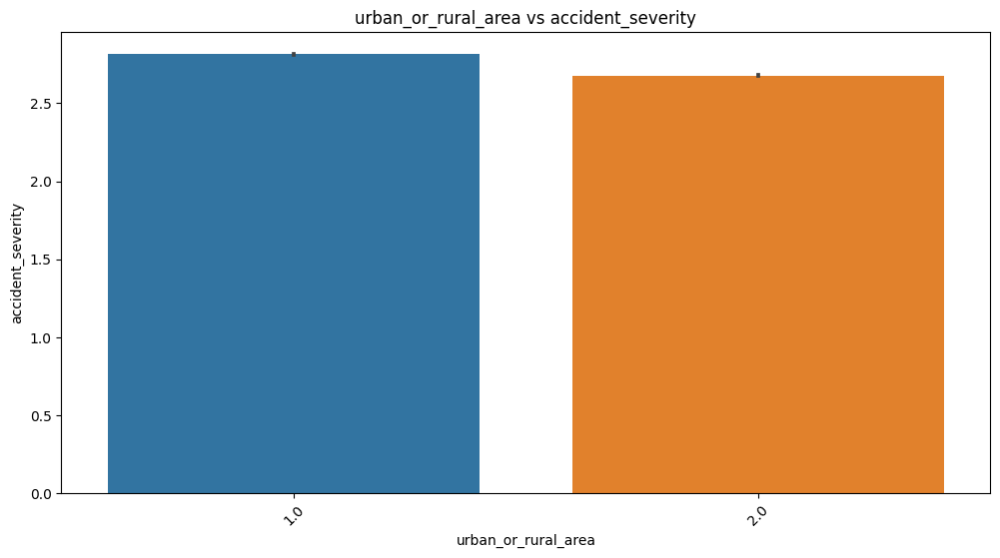

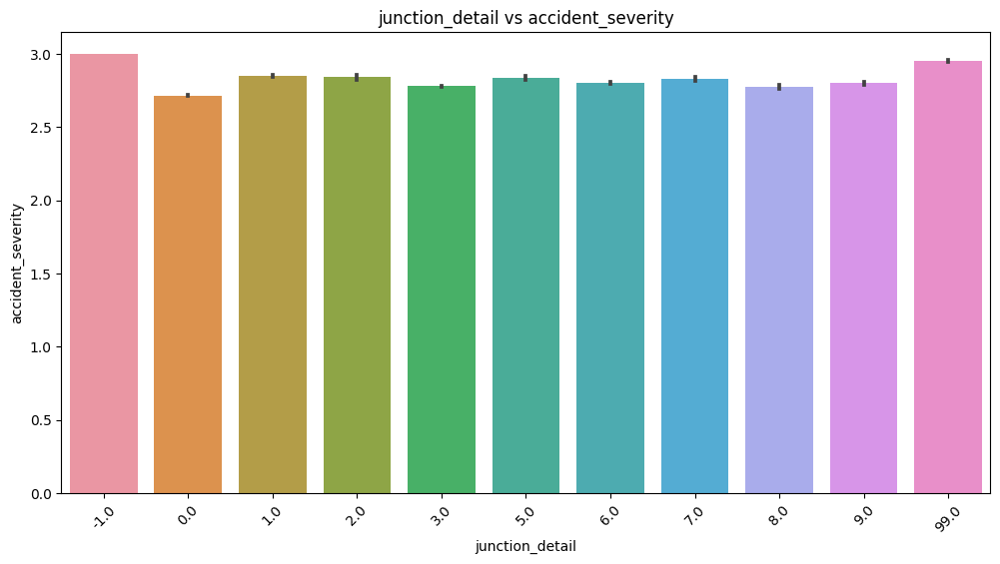

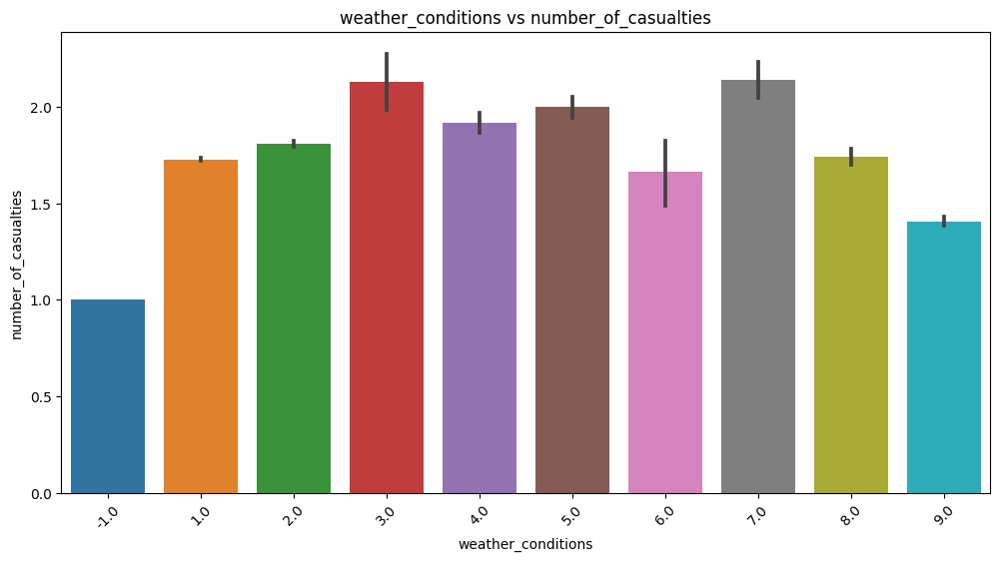

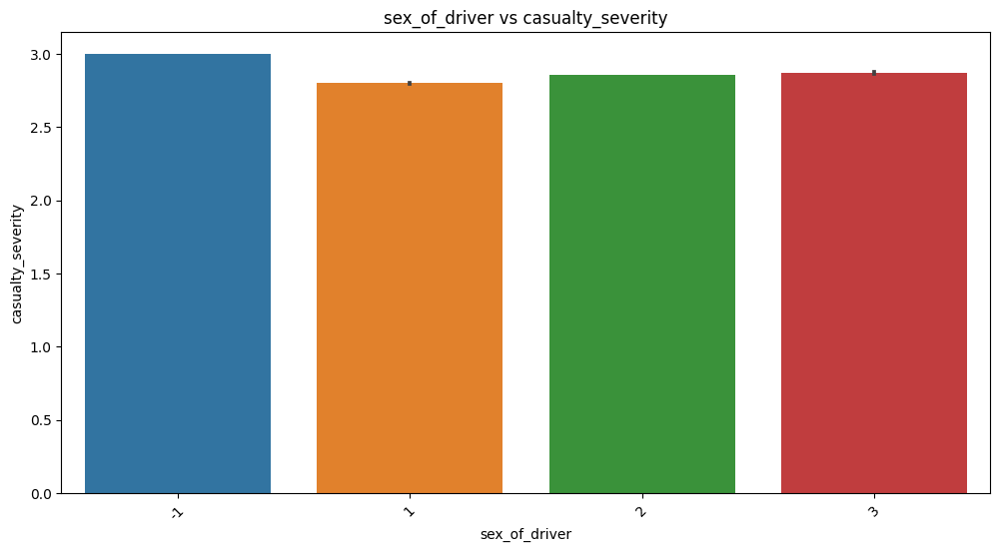

Skipping visualization for hour vs number_of_accidents as one of them is not present in the dataframe.


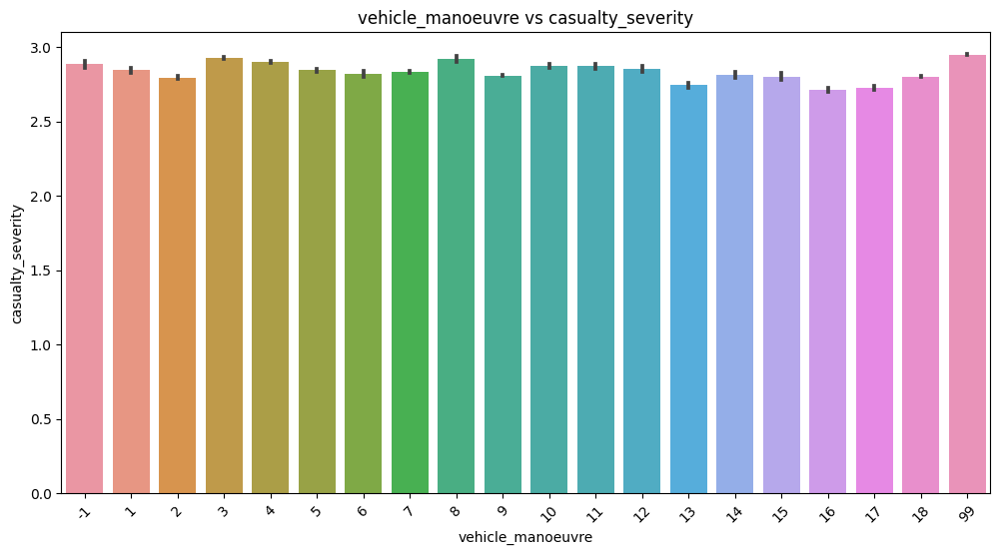

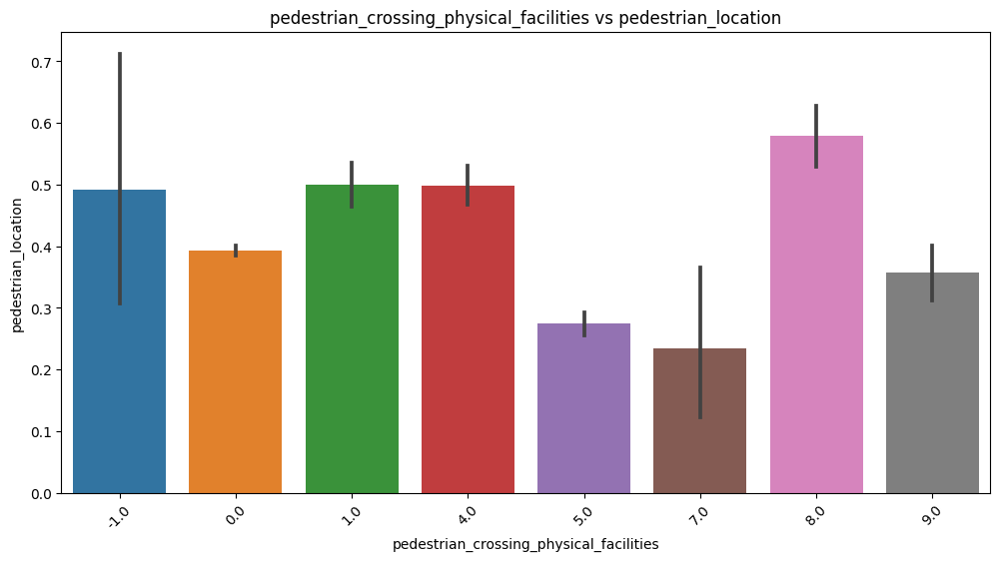

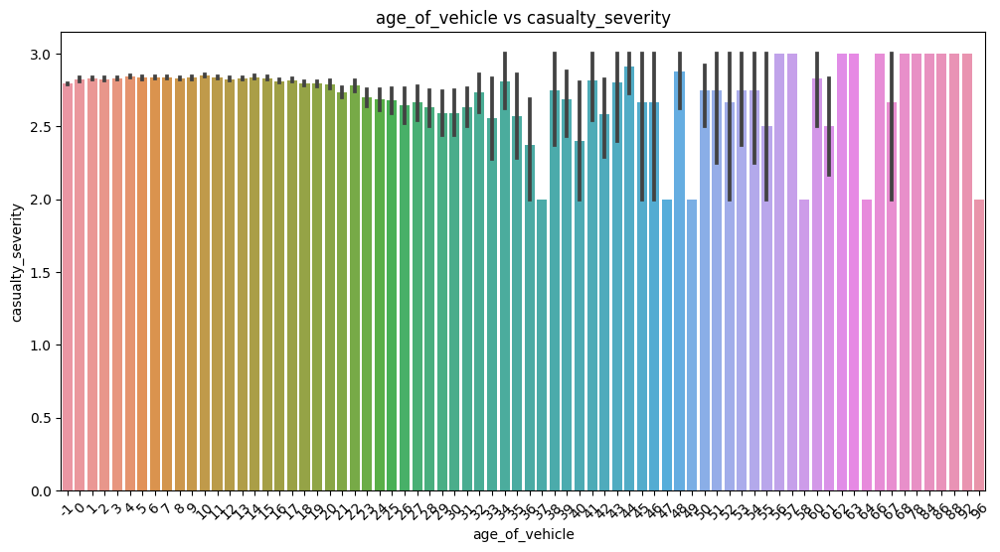

Skipping visualization for engine_capacity_cc vs casualty_severity as one of them is not present in the dataframe.


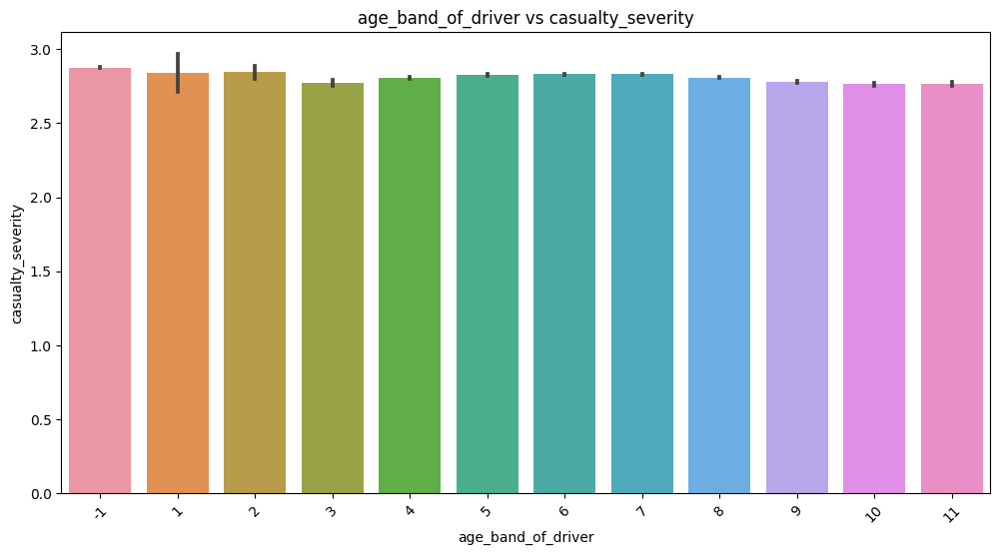

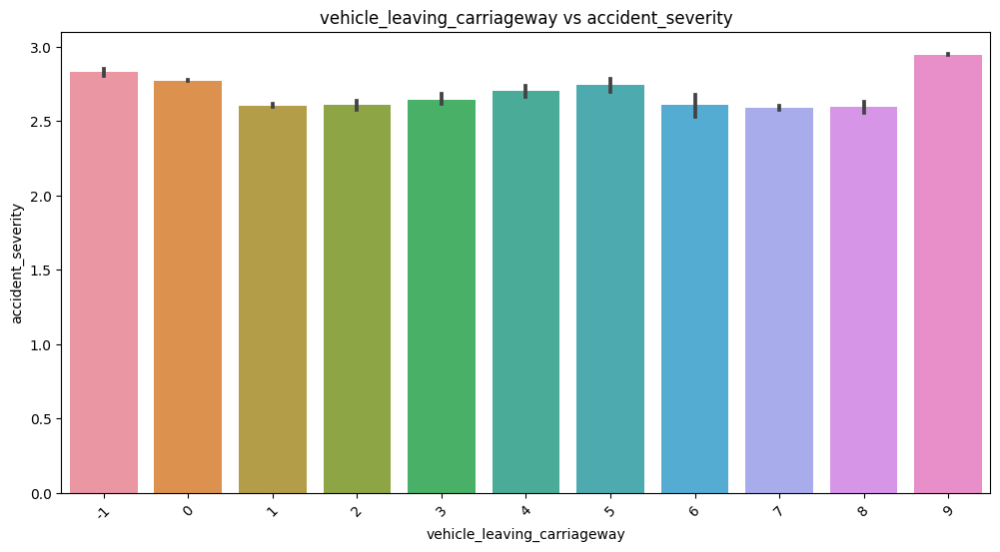

Skipping visualization for accident_year_x vs number_of_accidents as one of them is not present in the dataframe.
Skipping visualization for local_authority_district vs number_of_accidents as one of them is not present in the dataframe.


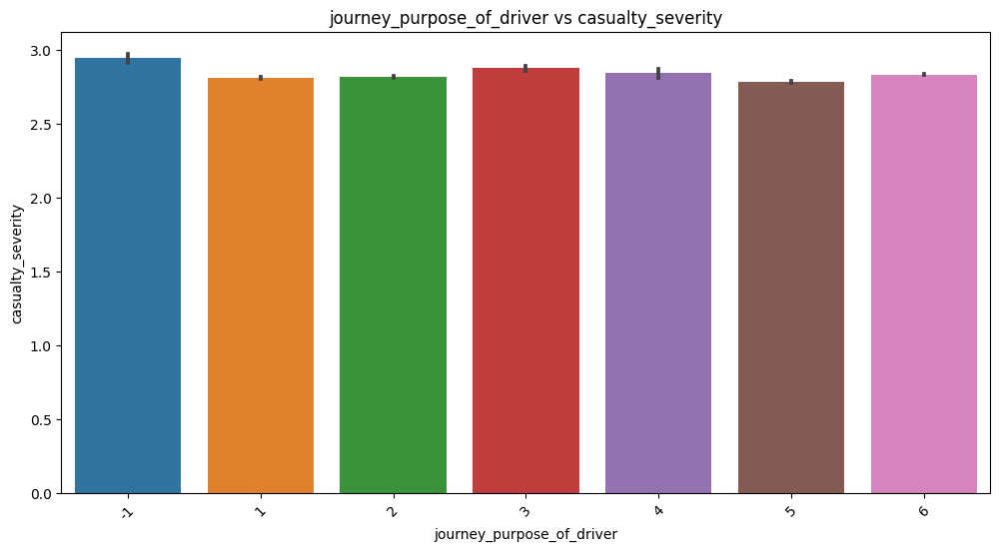

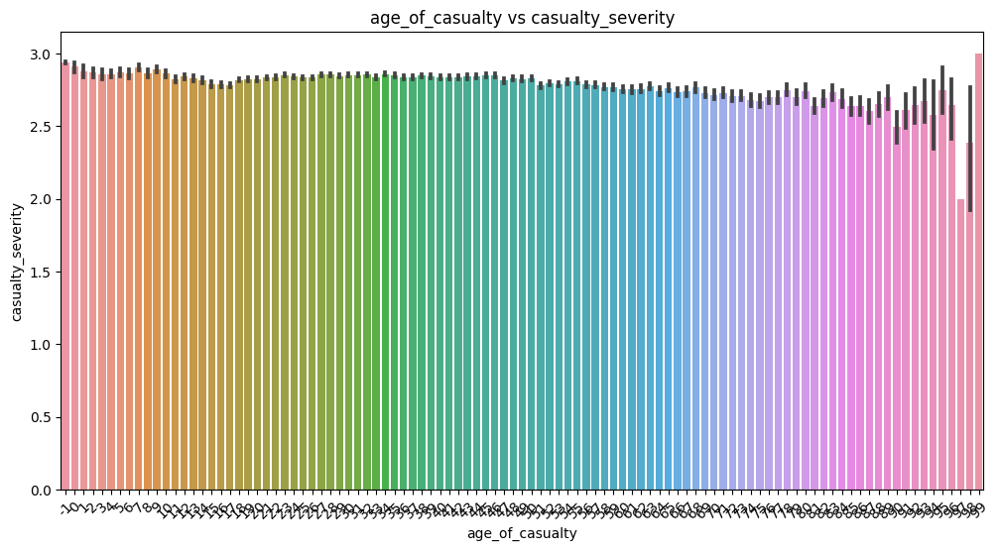

In [64]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd



combinations = [
    ('day_of_week', 'casualty_severity'),
    ('day_of_week', 'casualty_type'),
    ('weather_conditions', 'accident_severity'),
    ('number_of_vehicles', 'number_of_casualties'),
    ('light_conditions', 'casualty_type'),
    ('light_conditions', 'casualty_severity'),
    ('road_type', 'accident_severity'),
    ('vehicle_type', 'casualty_severity'),
    ('vehicle_type', 'casualty_type'),
    ('day_of_week', 'number_of_accidents'),
    ('urban_or_rural_area', 'accident_severity'),
    ('junction_detail', 'accident_severity'),
    ('weather_conditions', 'number_of_casualties'),
    ('sex_of_driver', 'casualty_severity'),
    ('hour', 'number_of_accidents'),
    ('vehicle_manoeuvre', 'casualty_severity'),
    ('pedestrian_crossing_physical_facilities', 'pedestrian_location'),
    ('age_of_vehicle', 'casualty_severity'),
    ('engine_capacity_cc', 'casualty_severity'),
    ('age_band_of_driver', 'casualty_severity'),
    ('vehicle_leaving_carriageway', 'accident_severity'),
    ('accident_year_x', 'number_of_accidents'),
    ('local_authority_district', 'number_of_accidents'),
    ('journey_purpose_of_driver', 'casualty_severity'),
    ('age_of_casualty', 'casualty_severity')
]




for x, y in combinations:
    # Handle if the column doesn't exist (to avoid errors)
    if x not in T.columns or y not in T.columns:
        print(f"Skipping visualization for {x} vs {y} as one of them is not present in the dataframe.")
        continue

    x_type = T[x].dtype
    y_type = T[y].dtype

    if x_type == 'O' and y_type == 'O':  # Both categorical
        plt.figure(figsize=(12, 6))
        sns.barplot(x=x, y=y, data=T)
        plt.title(f'{x} vs {y}')
        plt.xticks(rotation=45)
        plt.show()

    elif x_type == 'O' or y_type == 'O':  # One of them is categorical
        plt.figure(figsize=(12, 6))
        sns.barplot(x=x, y=y, data=T)
        plt.xticks(rotation=45)
        plt.title(f'{x} vs {y}')
        plt.show()

    else:  # Both are numeric
        plt.figure(figsize=(12, 6))
        sns.barplot(x=x, y=y, data=T)
        plt.title(f'{x} vs {y}')
        plt.xticks(rotation=45)
        plt.show()

    



### TIME SERIES

/Users/mac/opt/anaconda3/lib/python3.9/site-packages/pandas/core/tools/datetimes.py:1047: UserWarning: Parsing '27/04/2020' in DD/MM/YYYY format. Provide format or specify infer_datetime_format=True for consistent parsing.
  cache_array = _maybe_cache(arg, format, cache, convert_listlike)
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/pandas/core/tools/datetimes.py:1047: UserWarning: Parsing '13/01/2020' in DD/MM/YYYY format. Provide format or specify infer_datetime_format=True for consistent parsing.
  cache_array = _maybe_cache(arg, format, cache, convert_listlike)
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/pandas/core/tools/datetimes.py:1047: UserWarning: Parsing '14/01/2020' in DD/MM/YYYY format. Provide format or specify infer_datetime_format=True for consistent parsing.
  cache_array = _maybe_cache(arg, format, cache, convert_listlike)
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/pandas/core/tools/datetimes.py:1047: UserWarning: Parsing '15/01/2020' in DD/

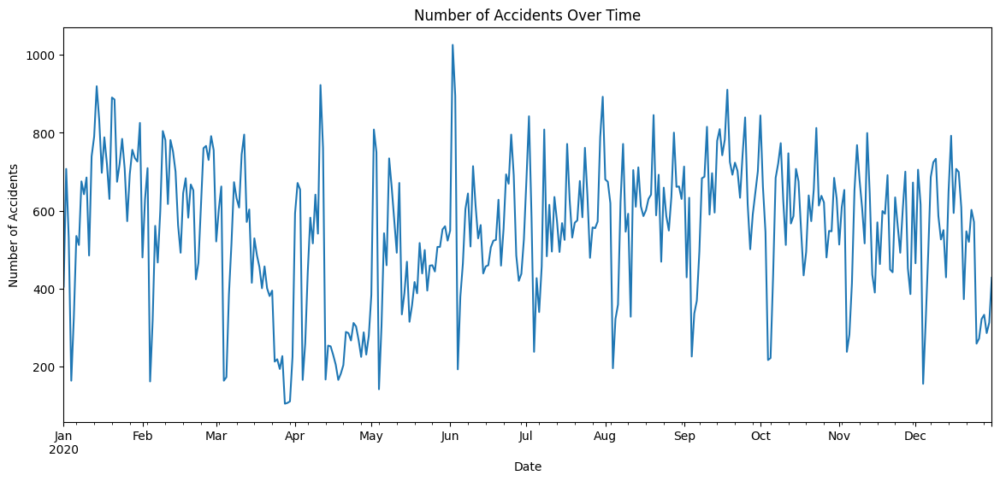

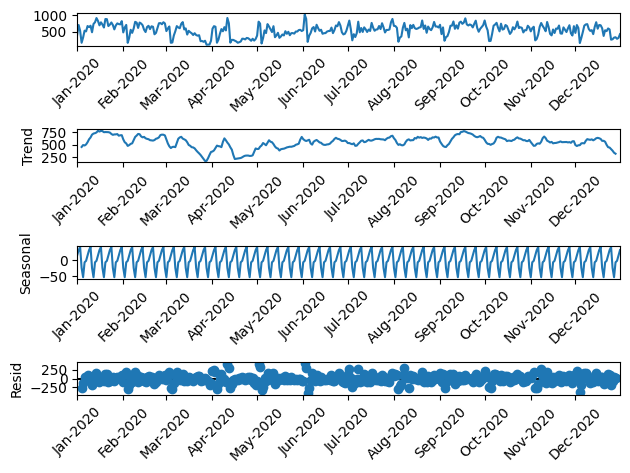

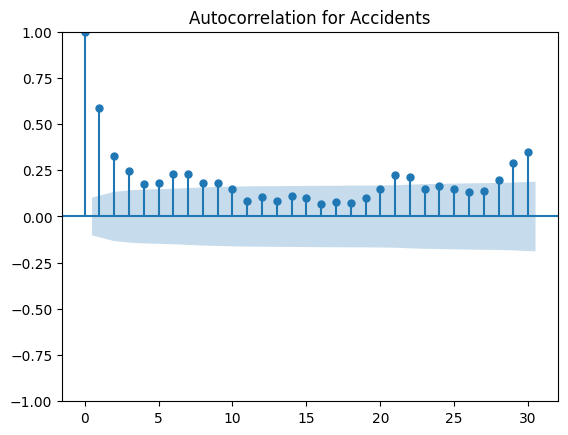

In [44]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf


# Ensure your date column is a datetime object and then sort it
T['date'] = pd.to_datetime(T['date'])
T = T.sort_values('date')

# Aggregate accidents on a daily basis
daily_accidents = T.groupby('date').size()

# Visualize accidents over time
plt.figure(figsize=(14, 6))
daily_accidents.plot()
plt.title('Number of Accidents Over Time')
plt.ylabel('Number of Accidents')
plt.xlabel('Date')
plt.show()

# Decompose the time series
result = seasonal_decompose(daily_accidents, model='additive')

import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# Plotting decomposition components
fig = result.plot()

# Adjust the x-axis to show dates in months
for ax in fig.axes:
    ax.xaxis.set_major_locator(mdates.MonthLocator())  # Place ticks on months
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%b-%Y'))  # Format ticks to show month and year
    plt.setp(ax.get_xticklabels(), rotation=45)  # Rotate the x-axis labels for better visibility

plt.tight_layout()
plt.show()

# Autocorrelation
plot_acf(daily_accidents, lags=30)  # Here, we're looking at autocorrelation for the past 30 days
plt.title('Autocorrelation for Accidents')
plt.show()



In [67]:
df.columns

Index(['accident_index', 'accident_year_x', 'accident_reference_x',
       'location_easting_osgr', 'location_northing_osgr', 'longitude',
       'latitude', 'police_force', 'accident_severity', 'number_of_vehicles',
       'number_of_casualties', 'date', 'day_of_week', 'time',
       'local_authority_district', 'local_authority_ons_district',
       'local_authority_highway', 'first_road_class', 'first_road_number',
       'road_type', 'speed_limit', 'junction_detail', 'junction_control',
       'second_road_class', 'second_road_number',
       'pedestrian_crossing_human_control',
       'pedestrian_crossing_physical_facilities', 'light_conditions',
       'weather_conditions', 'road_surface_conditions',
       'special_conditions_at_site', 'carriageway_hazards',
       'urban_or_rural_area', 'did_police_officer_attend_scene_of_accident',
       'trunk_road_flag', 'lsoa_of_accident_location', 'casualty_index',
       'accident_year_y', 'accident_reference_y', 'vehicle_reference_x',
  

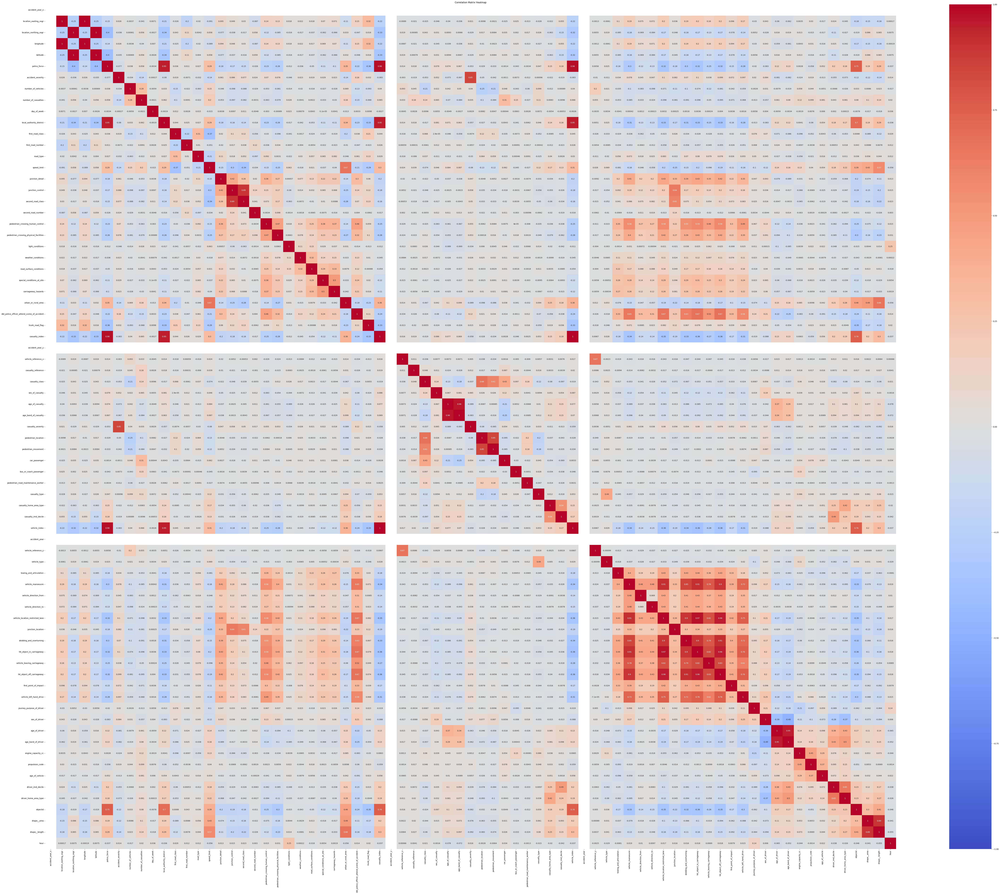

In [45]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt



# Select only numerical columns from the dataset to compute correlations
numerical_cols = T.select_dtypes(include=['float64', 'int64']).columns

# Compute the correlation matrix
corr_matrix = T[numerical_cols].corr()

# Visualize the correlation matrix using a heatmap
plt.figure(figsize=(100, 80))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Matrix Heatmap')
plt.show()


### MACHINE LEARNING MODELLING

In [46]:
# List of columns to check for keywords
cols_to_check = T.columns

# Keywords that might indicate index, ID, LSOA, or location coordinates
cols_to_drop = ['date','time','generic_make_model', 'engine_capacity_cc', 'local_authority_district', 'shape__area', 'shape__length','first_road_number', 'second_road_number', 'local_authority_highway', 'longitude', 'latitude', 'local_authority_ons_district', 'location_easting_osgr','location_northing_osgr' ,'lsoa01nmw','lsoa01nm','lsoa01cd',  'propulsion_code', 'objectid', 'globalid', 'accident_index', 'accident_year_x', 'accident_reference_x','casualty_index', 'lsoa_of_accident_location', ]



# Drop these columns
T = T.drop(columns=cols_to_drop)

print(f"Dropped columns: {cols_to_drop}")


Dropped columns: ['date', 'time', 'generic_make_model', 'engine_capacity_cc', 'local_authority_district', 'shape__area', 'shape__length', 'first_road_number', 'second_road_number', 'local_authority_highway', 'longitude', 'latitude', 'local_authority_ons_district', 'location_easting_osgr', 'location_northing_osgr', 'lsoa01nmw', 'lsoa01nm', 'lsoa01cd', 'propulsion_code', 'objectid', 'globalid', 'accident_index', 'accident_year_x', 'accident_reference_x', 'casualty_index', 'lsoa_of_accident_location']


In [47]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, accuracy_score


# 2. Encode categorical variables
label_encoders = {}
for column in T.select_dtypes(include=['object']).columns:
    le = LabelEncoder()
    T[column] = le.fit_transform(T[column])
    label_encoders[column] = le

# 3. Split the data
X = T.drop('accident_severity', axis=1)
y = T['accident_severity']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Normalize data
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# 4. Build and train the model
clf = RandomForestClassifier(n_estimators=100, random_state=42)
clf.fit(X_train, y_train)

# 5. Evaluate the model
y_pred = clf.predict(X_test)
print("Accuracy:", accuracy_score(y_test, y_pred))
print("\nClassification Report:\n", classification_report(y_test, y_pred))


/Users/mac/opt/anaconda3/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:1841: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:1841: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:1841: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy

Accuracy: 0.9710812349897249

Classification Report:
               precision    recall  f1-score   support

         1.0       1.00      0.78      0.87       763
         2.0       0.99      0.87      0.93      7943
         3.0       0.97      1.00      0.98     31683

    accuracy                           0.97     40389
   macro avg       0.99      0.88      0.93     40389
weighted avg       0.97      0.97      0.97     40389

